## Problem Statement: 
- Build a system/model to colorize the black and white image.

In [ ]:
## Data Source:
- 

## Libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import tensorflow.keras.backend as K
import tensorflow as tf
for device in tf.config.get_visible_devices('GPU'):
    tf.config.experimental.set_memory_growth(device, True)
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, load_img, img_to_array
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import *
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense, Input, Conv2DTranspose, Add, add, RepeatVector, Reshape, concatenate
import os
from tqdm import tqdm
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
import tensorflow.keras.applications as models
import tensorflow.keras.regularizers as reg
from tensorflow.keras.optimizers import Adam, RMSprop
import tensorflow.keras.initializers as initial
from sklearn.model_selection import train_test_split
from skimage.color import *
from skimage.transform import resize
from skimage.io import imread, imsave, imshow
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import EAM_layer
tf.config.run_functions_eagerly(True)
!nvidia-smi -L

GPU 0: NVIDIA GeForce GTX 1660 SUPER (UUID: GPU-68b71a8f-1517-bdfc-f8c4-0f0913519f9a)


## Data Loading

In [2]:
img_w = 256
img_h = 256
dim = (img_h, img_w, 3)

In [45]:
dirr = r'D:\Datasets\colorize_data/'
train_files = []
test_files = []
for x in os.listdir(dirr):
    path = dirr + x
    if 'train' in x:
        train_files += [f'{path}/{x}' for x in os.listdir(path)]    
    if 'test' in x:
        test_files += [f'{path}/{x}' for x in os.listdir(path)]    
train_files = pd.DataFrame(train_files)
test_files = pd.DataFrame(test_files)
len(train_files), len(test_files)

(22491, 5108)

In [4]:
def data_gen(data, batch_size = 32, augment = False): # Image Generator
    while True:
        X, Y1, Y2, Y3 = [], [], [], []
        sample = data.sample(batch_size).values
        for i in range(batch_size):
            x = load_img(sample[i][0], target_size = (img_h, img_w))
            x = np.array(x)/255
            if augment:
                ops = np.random.choice([None, np.fliplr, np.flipud])
                if ops:
                    x = ops(x)
            X.append(gray2rgb(rgb2gray(x)))
            r, g, b = np.split(x, 3, -1)
            Y1.append(r)
            Y2.append(g)
            Y3.append(b)

        X = np.array(X)
        Y1 = np.array(Y1)
        Y2 = np.array(Y2)
        Y3 = np.array(Y3)
        yield X, [Y1, Y2, Y3]

def img_rebuilder(L, Y):
    result = np.concatenate(Y, -1)
    return result

## Sample Images

In [5]:
bs = 10
train_data = data_gen(train_files, bs, True)
val_data = data_gen(test_files, bs)

In [6]:
X, Y = next(train_data)
Y1, Y2, Y3 = Y
print('Gray:',np.max(X[0, ...]), np.min(X[0, ...]))
print('R:',np.max(Y1[0, ...]), np.min(Y1[0, ...]))
print('G:',np.max(Y2[0, ...]), np.min(Y2[0, ...]))
print('B:',np.max(Y3[0, ...]), np.min(Y3[0, ...]))
print(X.shape, Y1.shape, Y2.shape, Y3.shape)

Gray: 0.9977380392156864 0.0
R: 1.0 0.0
G: 1.0 0.0
B: 0.9921568627450981 0.0
(10, 256, 256, 3) (10, 256, 256, 1) (10, 256, 256, 1) (10, 256, 256, 1)


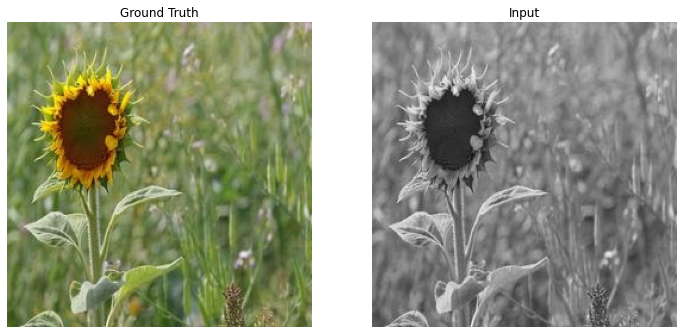

In [8]:
n = np.random.randint(0, len(X), 1)[0]
Y = Y1[n], Y2[n], Y3[n]
fig, ax = plt.subplots(1,2)
ax[0].imshow(img_rebuilder(X[n], Y))
ax[0].axis('off')
ax[0].set_title('Ground Truth')
ax[1].imshow(X[n], cmap = 'gray')
ax[1].axis('off')
ax[1].set_title('Input')
fig.set_figheight(15)
fig.set_figwidth(12)

## Model Architecture and Callbacks

In [7]:
class predict_disp(tf.keras.callbacks.Callback):
    def __init__(self, data = False):
        super(predict_disp, self).__init__()
    def on_epoch_end(self, epoch, logs = None):
        n = np.random.randint(0, bs, 1)[0]

        X, Y = next(val_data)
        Y1, Y2, Y3 = Y
        Y = Y1[n], Y2[n], Y3[n]
        
        X = tf.expand_dims(X[n], 0)
        pred = self.model.predict(X)
        pred = img_rebuilder(X[0], pred)[0]
        gt = img_rebuilder(X[0], Y)
        
        fig, ax = plt.subplots(1, 3)
        
        ax[0].imshow(X[0])
        ax[0].axis('off')
        ax[0].set_title('Input')
        
        ax[1].imshow(gt)
        ax[1].axis('off')
        ax[1].set_title('Grond Truth')
        
        ax[2].imshow(pred)
        ax[2].axis('off')
        ax[2].set_title('Prediction')
        
        fig.set_figheight(15)
        fig.set_figwidth(12)

        plt.show()

In [18]:
vgg = tf.keras.applications.VGG19(include_top = False, input_shape = dim)
vgg.trainable = False

vgg_outputs = []
for l in ['block1_conv2', 'block2_conv2', 'block3_conv3', 'block4_conv4', 'block5_conv4', 'block5_pool']:
    vgg_outputs.append(vgg.get_layer(l).output)

inp = vgg.input
feat = vgg_outputs[5]

feat = BatchNormalization()(feat)
up1 = Conv2DTranspose(512, kernel_size = 3, strides = 2, padding = 'same', name = 'up1', activation = 'relu')(feat)    
conv11 = Conv2D(512, kernel_size = 3, padding = 'same', name = 'conv11', activation = 'relu')(up1)    
conv12 = Conv2D(512, kernel_size = 3, padding = 'same', name = 'conv12', activation = 'relu')(conv11)   
add11 = Add(name = 'add11')([up1, conv11, conv12, vgg_outputs[4]])

add11 = BatchNormalization()(add11)
up2 = Conv2DTranspose(512, kernel_size = 3, strides = 2, padding = 'same', name = 'up2', activation = 'relu')(add11)    
conv21 = Conv2D(512, kernel_size = 3, padding = 'same', name = 'conv21', activation = 'relu')(up2)    
conv22 = Conv2D(512, kernel_size = 3, padding = 'same', name = 'conv22', activation = 'relu')(conv21)   
add21 = Add(name = 'add21')([up2, conv21, conv22, vgg_outputs[3]])

add21 = BatchNormalization()(add21)
up3 = Conv2DTranspose(256, kernel_size = 3, strides = 2, padding = 'same', name = 'up3', activation = 'relu')(add21)    
conv31 = Conv2D(256, kernel_size = 3, padding = 'same', name = 'conv31', activation = 'relu')(up3)    
conv32 = Conv2D(256, kernel_size = 3, padding = 'same', name = 'conv32', activation = 'relu')(conv31)   
add31 = Add(name = 'add31')([up3, conv31, conv32, vgg_outputs[2]])

add31 = BatchNormalization()(add31)
up4 = Conv2DTranspose(128, kernel_size = 3, strides = 2, padding = 'same', name = 'up4', activation = 'relu')(add31)    
conv41 = Conv2D(128, kernel_size = 3, padding = 'same', name = 'conv41', activation = 'relu')(up4)    
conv42 = Conv2D(128, kernel_size = 3, padding = 'same', name = 'conv42', activation = 'relu')(conv41)

add41 = Add(name = 'add41')([up4, conv41, conv42, vgg_outputs[1]])

add41 = BatchNormalization()(add41)
up5 = Conv2DTranspose(64, kernel_size = 3, strides = 2, padding = 'same', name = 'up5', activation = 'relu')(add41)    
conv51 = Conv2D(64, kernel_size = 3, padding = 'same', name = 'conv51', activation = 'relu')(up5)    
conv52 = Conv2D(64, kernel_size = 3, padding = 'same', name = 'conv52', activation = 'relu')(conv51)   
add51 = Add(name = 'add51')([up5, conv51, conv52, vgg_outputs[0]])

add51 = BatchNormalization()(add51)
r = Conv2D(1, kernel_size = 3, padding = 'same', name = 'R', activation = 'sigmoid')(add51)    
g = Conv2D(1, kernel_size = 3, padding = 'same', name = 'G', activation = 'sigmoid')(add51)    
b = Conv2D(1, kernel_size = 3, padding = 'same', name = 'B', activation = 'sigmoid')(add51)    

model = Model(inp, [r, g, b])
optimizer = tf.keras.optimizers.Adam(lr = 0.001)
loss = {'R' : 'mae', 'G': 'mae', 'B': 'mae'}
model.compile(optimizer, loss)
model.summary()

Model: "functional_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 256, 256, 64) 1792        input_3[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 256, 256, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 128, 128, 64) 0           block1_conv2[0][0]               
_______________________________________________________________________________________

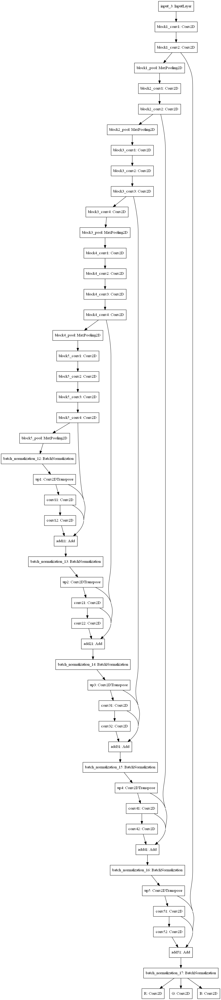

In [19]:
tf.keras.utils.plot_model(model, show_shapes = False) 

## Model Training

In [10]:
try:
    model = load_model('colorizer_model.h5', compile = False)
    loss = {'R' : 'mae', 'G': 'mae', 'B': 'mae'}
    optimizer = tf.keras.optimizers.Adam(lr = 0.001)
    model.compile(optimizer, loss)
except:
    pass

Epoch 40/3000
200/200 [==============================] - ETA: 0s - loss: 0.2267 - R_loss: 0.0797 - G_loss: 0.0339 - B_loss: 0.1131

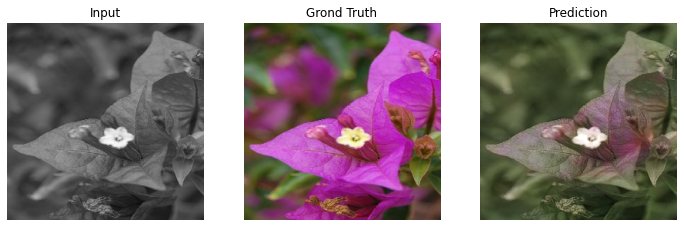


Epoch 00040: val_loss improved from inf to 0.22144, saving model to colorizer_model.h5
200/200 [==============================] - 196s 981ms/step - loss: 0.2267 - R_loss: 0.0797 - G_loss: 0.0339 - B_loss: 0.1131 - val_loss: 0.2214 - val_R_loss: 0.0831 - val_G_loss: 0.0311 - val_B_loss: 0.1072
Epoch 41/3000
200/200 [==============================] - ETA: 0s - loss: 0.2256 - R_loss: 0.0810 - G_loss: 0.0342 - B_loss: 0.1105

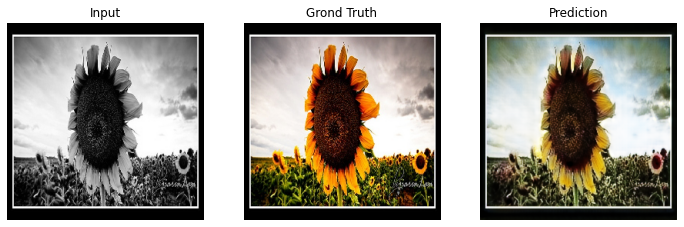


Epoch 00041: val_loss did not improve from 0.22144
200/200 [==============================] - 187s 933ms/step - loss: 0.2256 - R_loss: 0.0810 - G_loss: 0.0342 - B_loss: 0.1105 - val_loss: 0.2279 - val_R_loss: 0.0851 - val_G_loss: 0.0320 - val_B_loss: 0.1108
Epoch 42/3000
200/200 [==============================] - ETA: 0s - loss: 0.2222 - R_loss: 0.0785 - G_loss: 0.0328 - B_loss: 0.1109

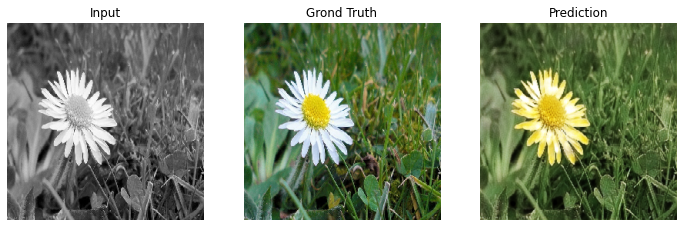


Epoch 00042: val_loss improved from 0.22144 to 0.22086, saving model to colorizer_model.h5
200/200 [==============================] - 182s 912ms/step - loss: 0.2222 - R_loss: 0.0785 - G_loss: 0.0328 - B_loss: 0.1109 - val_loss: 0.2209 - val_R_loss: 0.0804 - val_G_loss: 0.0309 - val_B_loss: 0.1095
Epoch 43/3000
200/200 [==============================] - ETA: 0s - loss: 0.2267 - R_loss: 0.0791 - G_loss: 0.0340 - B_loss: 0.1135

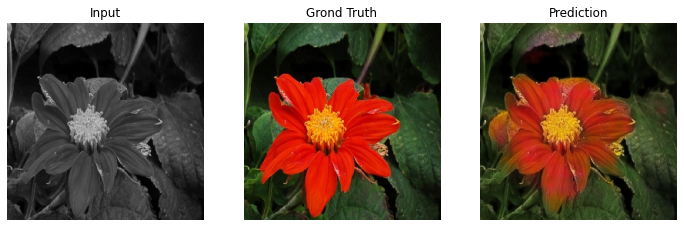


Epoch 00043: val_loss did not improve from 0.22086
200/200 [==============================] - 179s 895ms/step - loss: 0.2267 - R_loss: 0.0791 - G_loss: 0.0340 - B_loss: 0.1135 - val_loss: 0.2261 - val_R_loss: 0.0802 - val_G_loss: 0.0312 - val_B_loss: 0.1146
Epoch 44/3000
200/200 [==============================] - ETA: 0s - loss: 0.2250 - R_loss: 0.0804 - G_loss: 0.0341 - B_loss: 0.1106

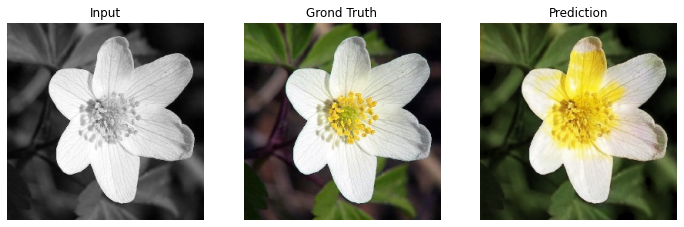


Epoch 00044: val_loss did not improve from 0.22086
200/200 [==============================] - 178s 890ms/step - loss: 0.2250 - R_loss: 0.0804 - G_loss: 0.0341 - B_loss: 0.1106 - val_loss: 0.2266 - val_R_loss: 0.0826 - val_G_loss: 0.0310 - val_B_loss: 0.1130
Epoch 45/3000
200/200 [==============================] - ETA: 0s - loss: 0.2231 - R_loss: 0.0789 - G_loss: 0.0338 - B_loss: 0.1104

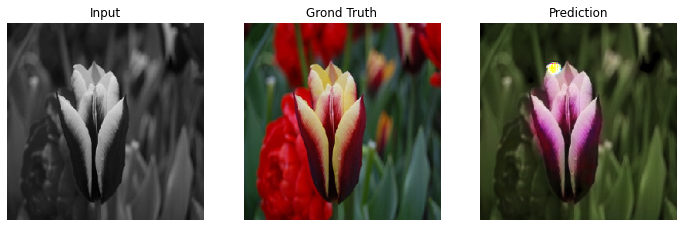


Epoch 00045: val_loss did not improve from 0.22086
200/200 [==============================] - 178s 888ms/step - loss: 0.2231 - R_loss: 0.0789 - G_loss: 0.0338 - B_loss: 0.1104 - val_loss: 0.2271 - val_R_loss: 0.0831 - val_G_loss: 0.0311 - val_B_loss: 0.1129
Epoch 46/3000
200/200 [==============================] - ETA: 0s - loss: 0.2271 - R_loss: 0.0798 - G_loss: 0.0335 - B_loss: 0.1139

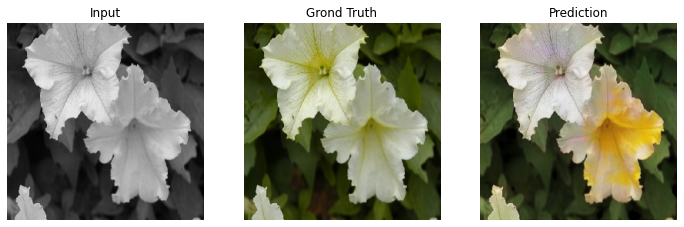


Epoch 00046: val_loss did not improve from 0.22086
200/200 [==============================] - 177s 885ms/step - loss: 0.2271 - R_loss: 0.0798 - G_loss: 0.0335 - B_loss: 0.1139 - val_loss: 0.2229 - val_R_loss: 0.0816 - val_G_loss: 0.0319 - val_B_loss: 0.1093
Epoch 47/3000
200/200 [==============================] - ETA: 0s - loss: 0.2214 - R_loss: 0.0793 - G_loss: 0.0334 - B_loss: 0.1088

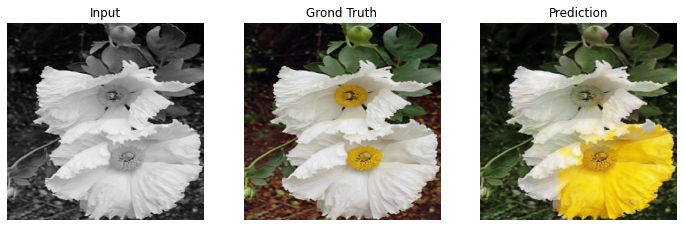


Epoch 00047: val_loss improved from 0.22086 to 0.22009, saving model to colorizer_model.h5
200/200 [==============================] - 178s 889ms/step - loss: 0.2214 - R_loss: 0.0793 - G_loss: 0.0334 - B_loss: 0.1088 - val_loss: 0.2201 - val_R_loss: 0.0802 - val_G_loss: 0.0321 - val_B_loss: 0.1079
Epoch 48/3000
200/200 [==============================] - ETA: 0s - loss: 0.2193 - R_loss: 0.0788 - G_loss: 0.0322 - B_loss: 0.1083

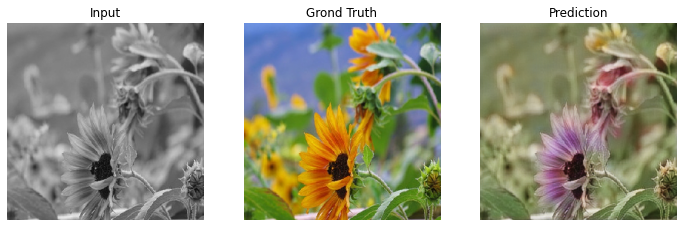


Epoch 00048: val_loss improved from 0.22009 to 0.21707, saving model to colorizer_model.h5
200/200 [==============================] - 178s 888ms/step - loss: 0.2193 - R_loss: 0.0788 - G_loss: 0.0322 - B_loss: 0.1083 - val_loss: 0.2171 - val_R_loss: 0.0809 - val_G_loss: 0.0311 - val_B_loss: 0.1051
Epoch 49/3000
200/200 [==============================] - ETA: 0s - loss: 0.2269 - R_loss: 0.0801 - G_loss: 0.0346 - B_loss: 0.1122

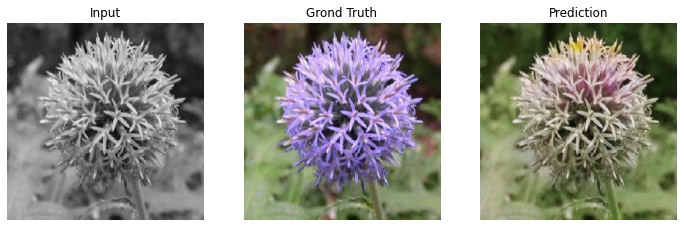


Epoch 00049: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 884ms/step - loss: 0.2269 - R_loss: 0.0801 - G_loss: 0.0346 - B_loss: 0.1122 - val_loss: 0.2208 - val_R_loss: 0.0801 - val_G_loss: 0.0312 - val_B_loss: 0.1094
Epoch 50/3000
200/200 [==============================] - ETA: 0s - loss: 0.2224 - R_loss: 0.0794 - G_loss: 0.0336 - B_loss: 0.1094

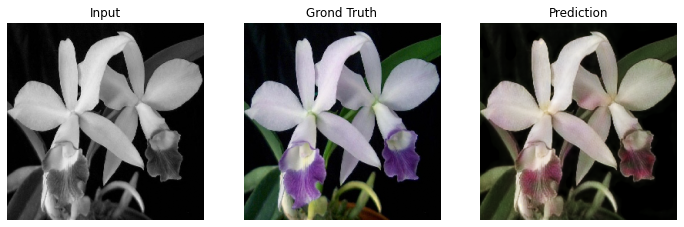


Epoch 00050: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 884ms/step - loss: 0.2224 - R_loss: 0.0794 - G_loss: 0.0336 - B_loss: 0.1094 - val_loss: 0.2176 - val_R_loss: 0.0802 - val_G_loss: 0.0298 - val_B_loss: 0.1075
Epoch 51/3000
200/200 [==============================] - ETA: 0s - loss: 0.2180 - R_loss: 0.0783 - G_loss: 0.0318 - B_loss: 0.1080

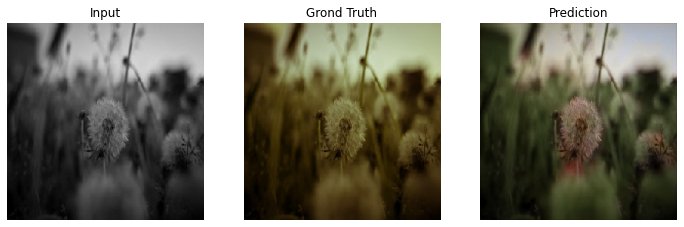


Epoch 00051: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 884ms/step - loss: 0.2180 - R_loss: 0.0783 - G_loss: 0.0318 - B_loss: 0.1080 - val_loss: 0.2177 - val_R_loss: 0.0801 - val_G_loss: 0.0308 - val_B_loss: 0.1068
Epoch 52/3000
200/200 [==============================] - ETA: 0s - loss: 0.2198 - R_loss: 0.0779 - G_loss: 0.0330 - B_loss: 0.1090

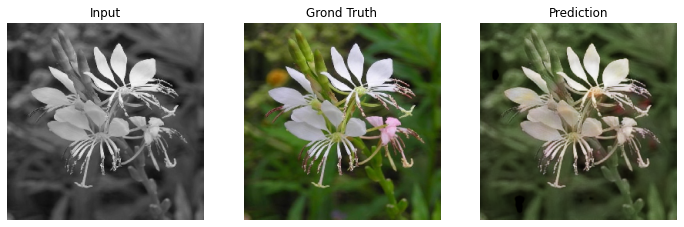


Epoch 00052: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 884ms/step - loss: 0.2198 - R_loss: 0.0779 - G_loss: 0.0330 - B_loss: 0.1090 - val_loss: 0.2234 - val_R_loss: 0.0820 - val_G_loss: 0.0304 - val_B_loss: 0.1110
Epoch 53/3000
200/200 [==============================] - ETA: 0s - loss: 0.2163 - R_loss: 0.0766 - G_loss: 0.0326 - B_loss: 0.1071

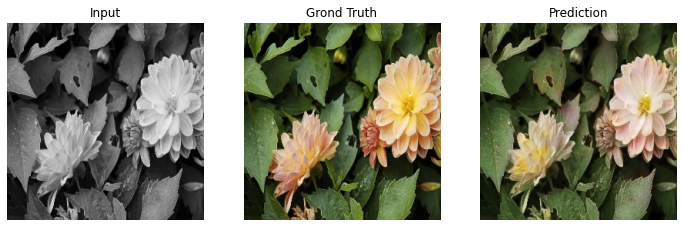


Epoch 00053: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 885ms/step - loss: 0.2163 - R_loss: 0.0766 - G_loss: 0.0326 - B_loss: 0.1071 - val_loss: 0.2220 - val_R_loss: 0.0830 - val_G_loss: 0.0309 - val_B_loss: 0.1080
Epoch 54/3000
200/200 [==============================] - ETA: 0s - loss: 0.2183 - R_loss: 0.0785 - G_loss: 0.0320 - B_loss: 0.1078

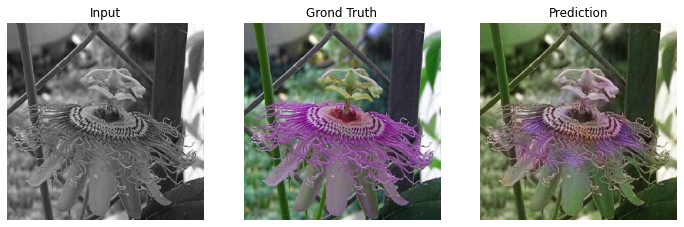


Epoch 00054: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 885ms/step - loss: 0.2183 - R_loss: 0.0785 - G_loss: 0.0320 - B_loss: 0.1078 - val_loss: 0.2188 - val_R_loss: 0.0794 - val_G_loss: 0.0302 - val_B_loss: 0.1093
Epoch 55/3000
200/200 [==============================] - ETA: 0s - loss: 0.2174 - R_loss: 0.0786 - G_loss: 0.0328 - B_loss: 0.1060

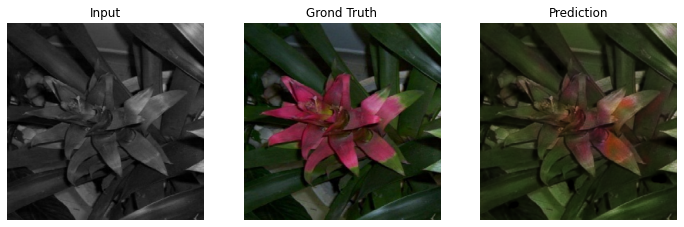


Epoch 00055: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 883ms/step - loss: 0.2174 - R_loss: 0.0786 - G_loss: 0.0328 - B_loss: 0.1060 - val_loss: 0.2295 - val_R_loss: 0.0850 - val_G_loss: 0.0318 - val_B_loss: 0.1127
Epoch 56/3000
200/200 [==============================] - ETA: 0s - loss: 0.2186 - R_loss: 0.0788 - G_loss: 0.0332 - B_loss: 0.1066

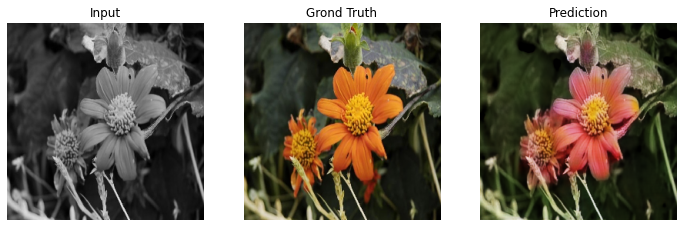


Epoch 00056: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 885ms/step - loss: 0.2186 - R_loss: 0.0788 - G_loss: 0.0332 - B_loss: 0.1066 - val_loss: 0.2190 - val_R_loss: 0.0791 - val_G_loss: 0.0316 - val_B_loss: 0.1083
Epoch 57/3000
200/200 [==============================] - ETA: 0s - loss: 0.2182 - R_loss: 0.0782 - G_loss: 0.0326 - B_loss: 0.1074

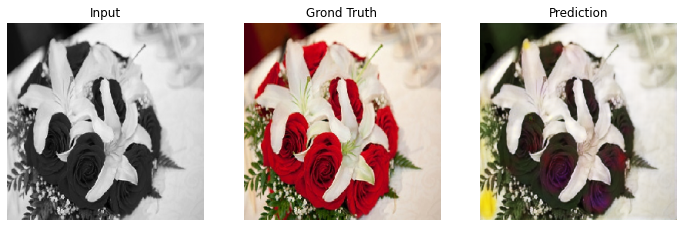


Epoch 00057: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 884ms/step - loss: 0.2182 - R_loss: 0.0782 - G_loss: 0.0326 - B_loss: 0.1074 - val_loss: 0.2242 - val_R_loss: 0.0800 - val_G_loss: 0.0304 - val_B_loss: 0.1137
Epoch 58/3000
200/200 [==============================] - ETA: 0s - loss: 0.2170 - R_loss: 0.0793 - G_loss: 0.0324 - B_loss: 0.1053

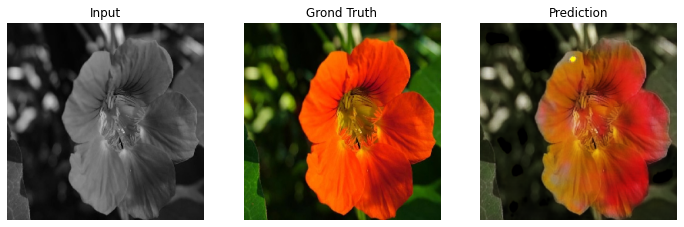


Epoch 00058: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 883ms/step - loss: 0.2170 - R_loss: 0.0793 - G_loss: 0.0324 - B_loss: 0.1053 - val_loss: 0.2195 - val_R_loss: 0.0792 - val_G_loss: 0.0307 - val_B_loss: 0.1096
Epoch 59/3000
200/200 [==============================] - ETA: 0s - loss: 0.2193 - R_loss: 0.0787 - G_loss: 0.0337 - B_loss: 0.1069

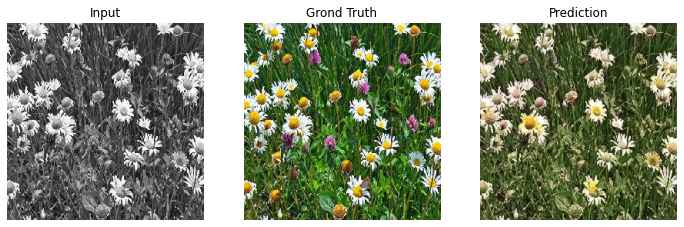


Epoch 00059: val_loss did not improve from 0.21707
200/200 [==============================] - 177s 883ms/step - loss: 0.2193 - R_loss: 0.0787 - G_loss: 0.0337 - B_loss: 0.1069 - val_loss: 0.2229 - val_R_loss: 0.0827 - val_G_loss: 0.0306 - val_B_loss: 0.1096
Epoch 60/3000
200/200 [==============================] - ETA: 0s - loss: 0.2183 - R_loss: 0.0779 - G_loss: 0.0322 - B_loss: 0.1081

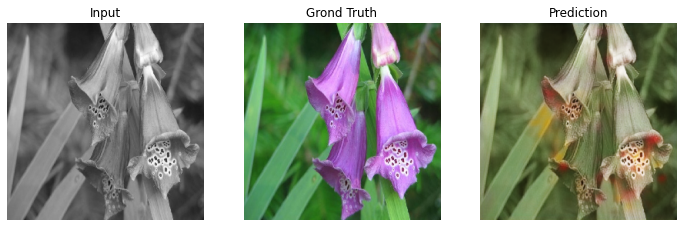


Epoch 00060: val_loss improved from 0.21707 to 0.21412, saving model to colorizer_model.h5
200/200 [==============================] - 177s 887ms/step - loss: 0.2183 - R_loss: 0.0779 - G_loss: 0.0322 - B_loss: 0.1081 - val_loss: 0.2141 - val_R_loss: 0.0786 - val_G_loss: 0.0293 - val_B_loss: 0.1062
Epoch 61/3000
200/200 [==============================] - ETA: 0s - loss: 0.2185 - R_loss: 0.0790 - G_loss: 0.0325 - B_loss: 0.1070

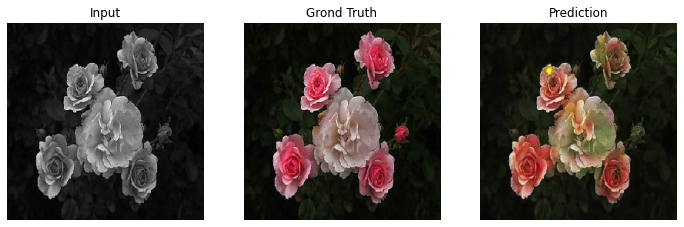


Epoch 00061: val_loss did not improve from 0.21412
200/200 [==============================] - 177s 884ms/step - loss: 0.2185 - R_loss: 0.0790 - G_loss: 0.0325 - B_loss: 0.1070 - val_loss: 0.2196 - val_R_loss: 0.0787 - val_G_loss: 0.0303 - val_B_loss: 0.1106
Epoch 62/3000
200/200 [==============================] - ETA: 0s - loss: 0.2231 - R_loss: 0.0795 - G_loss: 0.0333 - B_loss: 0.1102

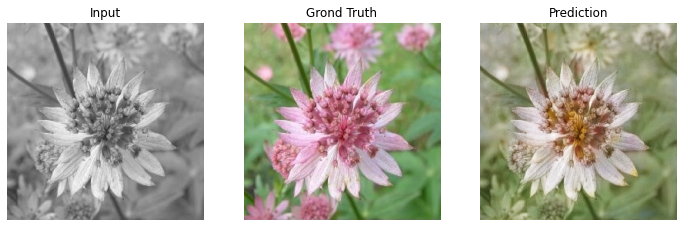


Epoch 00062: val_loss did not improve from 0.21412
200/200 [==============================] - 177s 885ms/step - loss: 0.2231 - R_loss: 0.0795 - G_loss: 0.0333 - B_loss: 0.1102 - val_loss: 0.2181 - val_R_loss: 0.0791 - val_G_loss: 0.0297 - val_B_loss: 0.1094
Epoch 63/3000
200/200 [==============================] - ETA: 0s - loss: 0.2162 - R_loss: 0.0779 - G_loss: 0.0320 - B_loss: 0.1062

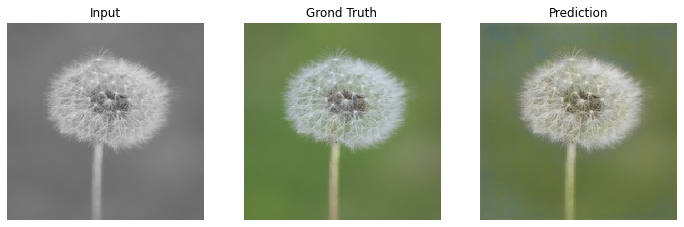


Epoch 00063: val_loss did not improve from 0.21412
200/200 [==============================] - 177s 884ms/step - loss: 0.2162 - R_loss: 0.0779 - G_loss: 0.0320 - B_loss: 0.1062 - val_loss: 0.2206 - val_R_loss: 0.0819 - val_G_loss: 0.0300 - val_B_loss: 0.1086
Epoch 64/3000
200/200 [==============================] - ETA: 0s - loss: 0.2163 - R_loss: 0.0777 - G_loss: 0.0316 - B_loss: 0.1070

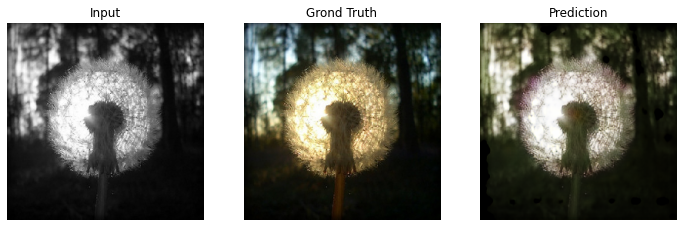


Epoch 00064: val_loss did not improve from 0.21412
200/200 [==============================] - 177s 884ms/step - loss: 0.2163 - R_loss: 0.0777 - G_loss: 0.0316 - B_loss: 0.1070 - val_loss: 0.2251 - val_R_loss: 0.0840 - val_G_loss: 0.0325 - val_B_loss: 0.1087
Epoch 65/3000
200/200 [==============================] - ETA: 0s - loss: 0.2125 - R_loss: 0.0767 - G_loss: 0.0314 - B_loss: 0.1044

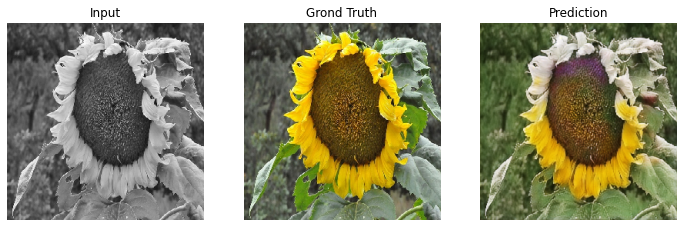


Epoch 00065: val_loss did not improve from 0.21412
200/200 [==============================] - 177s 884ms/step - loss: 0.2125 - R_loss: 0.0767 - G_loss: 0.0314 - B_loss: 0.1044 - val_loss: 0.2183 - val_R_loss: 0.0808 - val_G_loss: 0.0313 - val_B_loss: 0.1061
Epoch 66/3000
200/200 [==============================] - ETA: 0s - loss: 0.2144 - R_loss: 0.0773 - G_loss: 0.0320 - B_loss: 0.1051

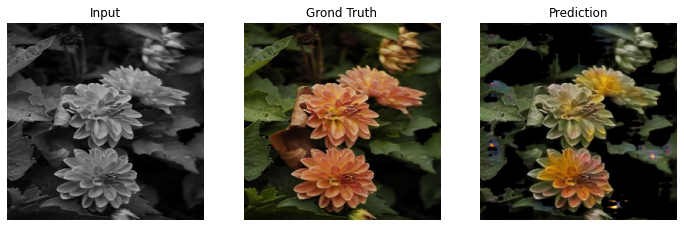


Epoch 00066: val_loss did not improve from 0.21412
200/200 [==============================] - 181s 904ms/step - loss: 0.2144 - R_loss: 0.0773 - G_loss: 0.0320 - B_loss: 0.1051 - val_loss: 0.2458 - val_R_loss: 0.0907 - val_G_loss: 0.0414 - val_B_loss: 0.1136
Epoch 67/3000
200/200 [==============================] - ETA: 0s - loss: 0.2134 - R_loss: 0.0754 - G_loss: 0.0317 - B_loss: 0.1063

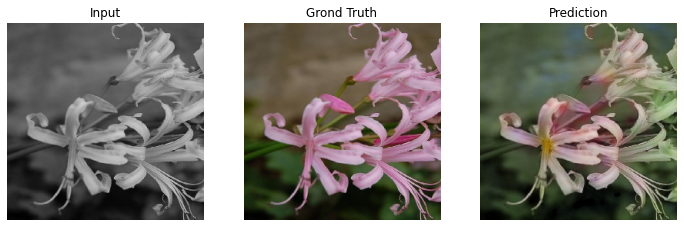


Epoch 00067: val_loss did not improve from 0.21412
200/200 [==============================] - 178s 889ms/step - loss: 0.2134 - R_loss: 0.0754 - G_loss: 0.0317 - B_loss: 0.1063 - val_loss: 0.2213 - val_R_loss: 0.0811 - val_G_loss: 0.0299 - val_B_loss: 0.1103
Epoch 68/3000
200/200 [==============================] - ETA: 0s - loss: 0.2120 - R_loss: 0.0754 - G_loss: 0.0305 - B_loss: 0.1060

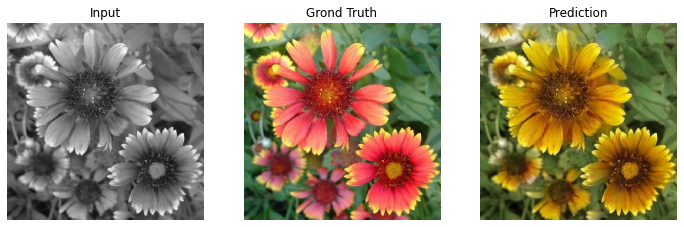


Epoch 00068: val_loss did not improve from 0.21412
200/200 [==============================] - 179s 893ms/step - loss: 0.2120 - R_loss: 0.0754 - G_loss: 0.0305 - B_loss: 0.1060 - val_loss: 0.2198 - val_R_loss: 0.0803 - val_G_loss: 0.0299 - val_B_loss: 0.1096
Epoch 69/3000
200/200 [==============================] - ETA: 0s - loss: 0.2181 - R_loss: 0.0774 - G_loss: 0.0330 - B_loss: 0.1078

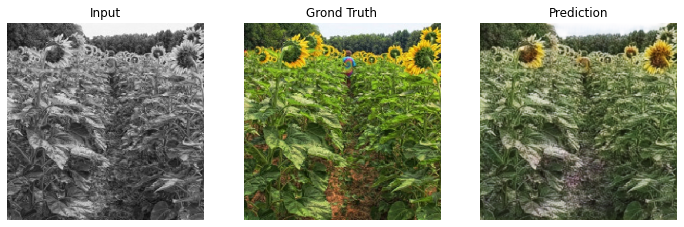


Epoch 00069: val_loss did not improve from 0.21412
200/200 [==============================] - 199s 997ms/step - loss: 0.2181 - R_loss: 0.0774 - G_loss: 0.0330 - B_loss: 0.1078 - val_loss: 0.2258 - val_R_loss: 0.0817 - val_G_loss: 0.0308 - val_B_loss: 0.1134
Epoch 70/3000
200/200 [==============================] - ETA: 0s - loss: 0.2184 - R_loss: 0.0784 - G_loss: 0.0332 - B_loss: 0.1068

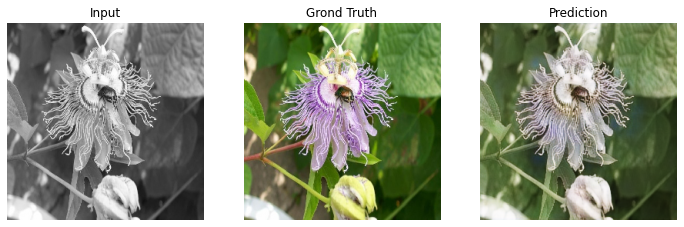


Epoch 00070: val_loss improved from 0.21412 to 0.21089, saving model to colorizer_model.h5
200/200 [==============================] - 190s 948ms/step - loss: 0.2184 - R_loss: 0.0784 - G_loss: 0.0332 - B_loss: 0.1068 - val_loss: 0.2109 - val_R_loss: 0.0774 - val_G_loss: 0.0295 - val_B_loss: 0.1040
Epoch 71/3000
200/200 [==============================] - ETA: 0s - loss: 0.2128 - R_loss: 0.0764 - G_loss: 0.0315 - B_loss: 0.1049

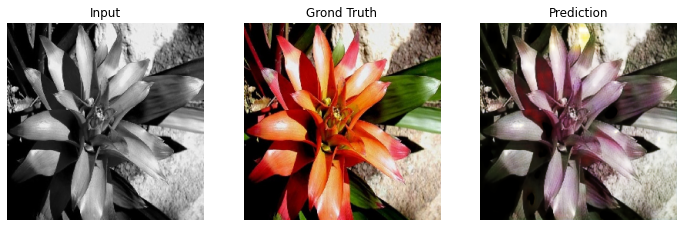


Epoch 00071: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2128 - R_loss: 0.0764 - G_loss: 0.0315 - B_loss: 0.1049 - val_loss: 0.2164 - val_R_loss: 0.0805 - val_G_loss: 0.0295 - val_B_loss: 0.1065
Epoch 72/3000
200/200 [==============================] - ETA: 0s - loss: 0.2119 - R_loss: 0.0744 - G_loss: 0.0313 - B_loss: 0.1063

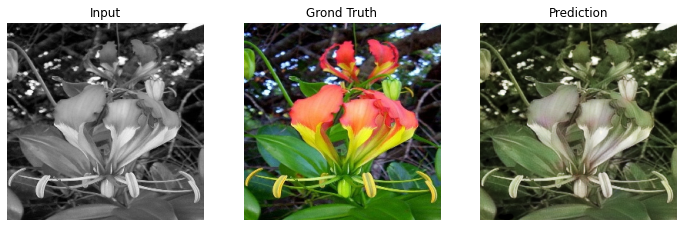


Epoch 00072: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2119 - R_loss: 0.0744 - G_loss: 0.0313 - B_loss: 0.1063 - val_loss: 0.2175 - val_R_loss: 0.0821 - val_G_loss: 0.0312 - val_B_loss: 0.1042
Epoch 73/3000
200/200 [==============================] - ETA: 0s - loss: 0.2199 - R_loss: 0.0785 - G_loss: 0.0325 - B_loss: 0.1089

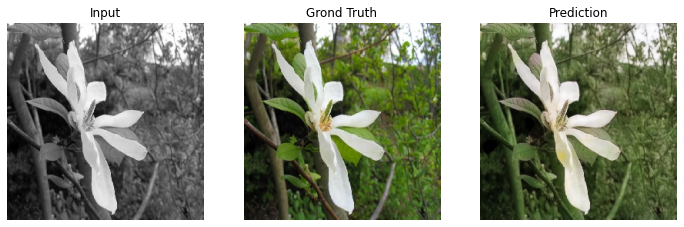


Epoch 00073: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2199 - R_loss: 0.0785 - G_loss: 0.0325 - B_loss: 0.1089 - val_loss: 0.2209 - val_R_loss: 0.0802 - val_G_loss: 0.0309 - val_B_loss: 0.1099
Epoch 74/3000
200/200 [==============================] - ETA: 0s - loss: 0.2162 - R_loss: 0.0776 - G_loss: 0.0323 - B_loss: 0.1064

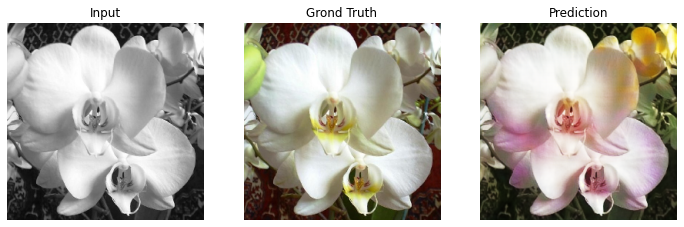


Epoch 00074: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2162 - R_loss: 0.0776 - G_loss: 0.0323 - B_loss: 0.1064 - val_loss: 0.2188 - val_R_loss: 0.0782 - val_G_loss: 0.0316 - val_B_loss: 0.1090
Epoch 75/3000
200/200 [==============================] - ETA: 0s - loss: 0.2098 - R_loss: 0.0747 - G_loss: 0.0309 - B_loss: 0.1042

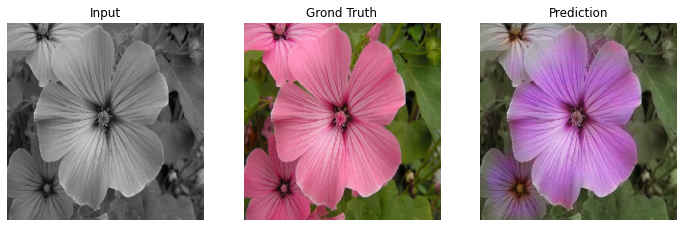


Epoch 00075: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2098 - R_loss: 0.0747 - G_loss: 0.0309 - B_loss: 0.1042 - val_loss: 0.2204 - val_R_loss: 0.0816 - val_G_loss: 0.0312 - val_B_loss: 0.1076
Epoch 76/3000
200/200 [==============================] - ETA: 0s - loss: 0.2171 - R_loss: 0.0772 - G_loss: 0.0323 - B_loss: 0.1076

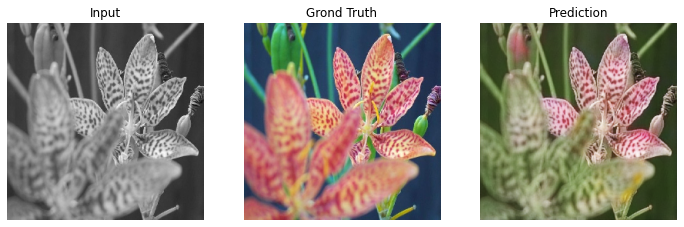


Epoch 00076: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 885ms/step - loss: 0.2171 - R_loss: 0.0772 - G_loss: 0.0323 - B_loss: 0.1076 - val_loss: 0.2199 - val_R_loss: 0.0801 - val_G_loss: 0.0317 - val_B_loss: 0.1081
Epoch 77/3000
200/200 [==============================] - ETA: 0s - loss: 0.2129 - R_loss: 0.0760 - G_loss: 0.0322 - B_loss: 0.1047

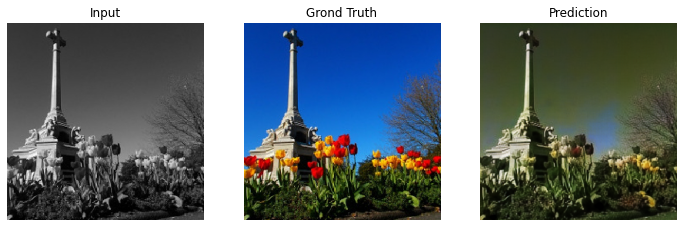


Epoch 00077: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2129 - R_loss: 0.0760 - G_loss: 0.0322 - B_loss: 0.1047 - val_loss: 0.2119 - val_R_loss: 0.0775 - val_G_loss: 0.0292 - val_B_loss: 0.1053
Epoch 78/3000
200/200 [==============================] - ETA: 0s - loss: 0.2108 - R_loss: 0.0760 - G_loss: 0.0302 - B_loss: 0.1046

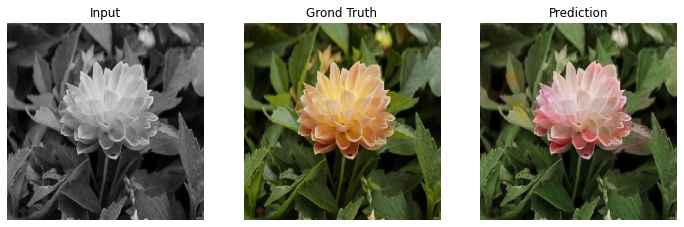


Epoch 00078: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 885ms/step - loss: 0.2108 - R_loss: 0.0760 - G_loss: 0.0302 - B_loss: 0.1046 - val_loss: 0.2184 - val_R_loss: 0.0788 - val_G_loss: 0.0294 - val_B_loss: 0.1103
Epoch 79/3000
200/200 [==============================] - ETA: 0s - loss: 0.2093 - R_loss: 0.0757 - G_loss: 0.0316 - B_loss: 0.1019

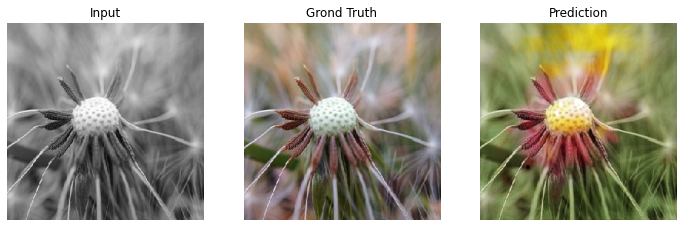


Epoch 00079: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2093 - R_loss: 0.0757 - G_loss: 0.0316 - B_loss: 0.1019 - val_loss: 0.2153 - val_R_loss: 0.0786 - val_G_loss: 0.0292 - val_B_loss: 0.1075
Epoch 80/3000
200/200 [==============================] - ETA: 0s - loss: 0.2117 - R_loss: 0.0759 - G_loss: 0.0312 - B_loss: 0.1045

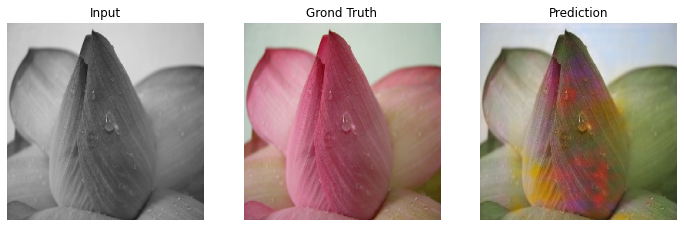


Epoch 00080: val_loss did not improve from 0.21089
200/200 [==============================] - 178s 888ms/step - loss: 0.2117 - R_loss: 0.0759 - G_loss: 0.0312 - B_loss: 0.1045 - val_loss: 0.2186 - val_R_loss: 0.0799 - val_G_loss: 0.0302 - val_B_loss: 0.1085
Epoch 81/3000
200/200 [==============================] - ETA: 0s - loss: 0.2099 - R_loss: 0.0755 - G_loss: 0.0302 - B_loss: 0.1042

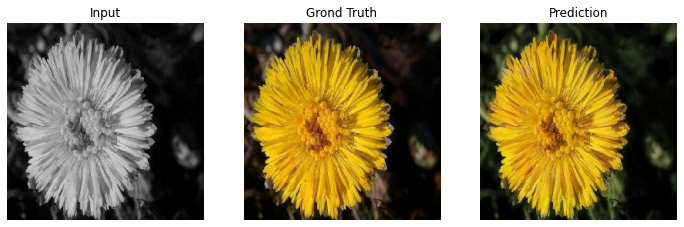


Epoch 00081: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2099 - R_loss: 0.0755 - G_loss: 0.0302 - B_loss: 0.1042 - val_loss: 0.2160 - val_R_loss: 0.0788 - val_G_loss: 0.0301 - val_B_loss: 0.1071
Epoch 82/3000
200/200 [==============================] - ETA: 0s - loss: 0.2117 - R_loss: 0.0761 - G_loss: 0.0300 - B_loss: 0.1056

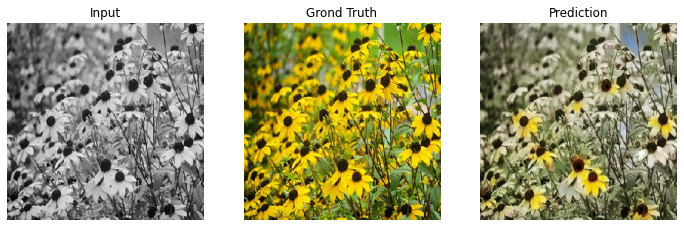


Epoch 00082: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2117 - R_loss: 0.0761 - G_loss: 0.0300 - B_loss: 0.1056 - val_loss: 0.2167 - val_R_loss: 0.0786 - val_G_loss: 0.0299 - val_B_loss: 0.1082
Epoch 83/3000
200/200 [==============================] - ETA: 0s - loss: 0.2108 - R_loss: 0.0754 - G_loss: 0.0306 - B_loss: 0.1048

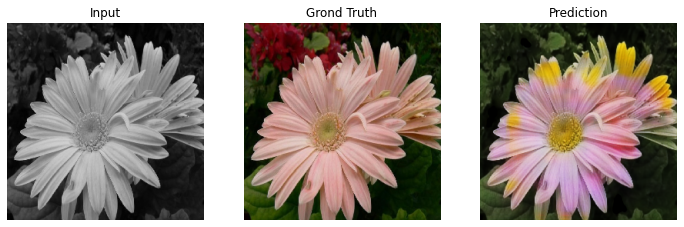


Epoch 00083: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2108 - R_loss: 0.0754 - G_loss: 0.0306 - B_loss: 0.1048 - val_loss: 0.2175 - val_R_loss: 0.0790 - val_G_loss: 0.0291 - val_B_loss: 0.1094
Epoch 84/3000
200/200 [==============================] - ETA: 0s - loss: 0.2093 - R_loss: 0.0752 - G_loss: 0.0304 - B_loss: 0.1036

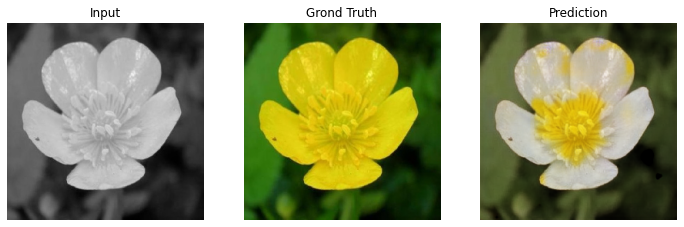


Epoch 00084: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2093 - R_loss: 0.0752 - G_loss: 0.0304 - B_loss: 0.1036 - val_loss: 0.2138 - val_R_loss: 0.0804 - val_G_loss: 0.0299 - val_B_loss: 0.1035
Epoch 85/3000
200/200 [==============================] - ETA: 0s - loss: 0.2139 - R_loss: 0.0769 - G_loss: 0.0313 - B_loss: 0.1057

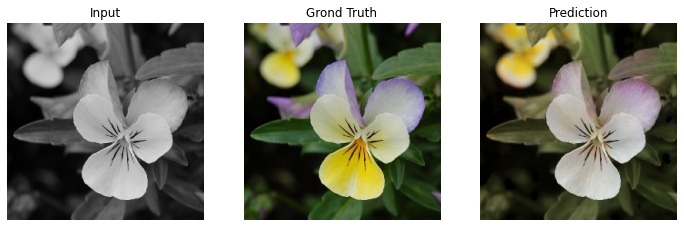


Epoch 00085: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 883ms/step - loss: 0.2139 - R_loss: 0.0769 - G_loss: 0.0313 - B_loss: 0.1057 - val_loss: 0.2175 - val_R_loss: 0.0801 - val_G_loss: 0.0314 - val_B_loss: 0.1059
Epoch 86/3000
200/200 [==============================] - ETA: 0s - loss: 0.2069 - R_loss: 0.0734 - G_loss: 0.0302 - B_loss: 0.1033

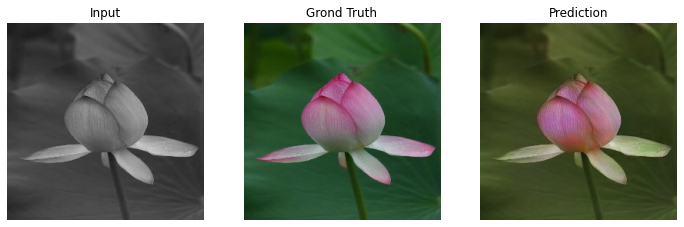


Epoch 00086: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 883ms/step - loss: 0.2069 - R_loss: 0.0734 - G_loss: 0.0302 - B_loss: 0.1033 - val_loss: 0.2165 - val_R_loss: 0.0817 - val_G_loss: 0.0299 - val_B_loss: 0.1050
Epoch 87/3000
200/200 [==============================] - ETA: 0s - loss: 0.2114 - R_loss: 0.0742 - G_loss: 0.0313 - B_loss: 0.1059

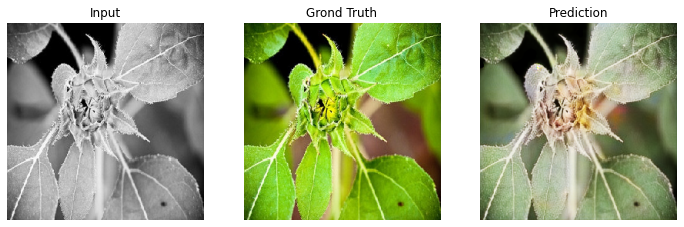


Epoch 00087: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2114 - R_loss: 0.0742 - G_loss: 0.0313 - B_loss: 0.1059 - val_loss: 0.2119 - val_R_loss: 0.0771 - val_G_loss: 0.0284 - val_B_loss: 0.1064
Epoch 88/3000
200/200 [==============================] - ETA: 0s - loss: 0.2072 - R_loss: 0.0749 - G_loss: 0.0301 - B_loss: 0.1021

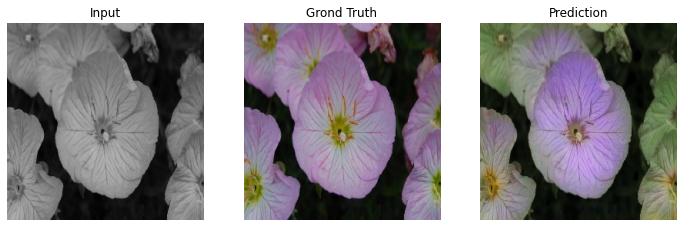


Epoch 00088: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 884ms/step - loss: 0.2072 - R_loss: 0.0749 - G_loss: 0.0301 - B_loss: 0.1021 - val_loss: 0.2164 - val_R_loss: 0.0827 - val_G_loss: 0.0292 - val_B_loss: 0.1044
Epoch 89/3000
200/200 [==============================] - ETA: 0s - loss: 0.2081 - R_loss: 0.0751 - G_loss: 0.0302 - B_loss: 0.1028

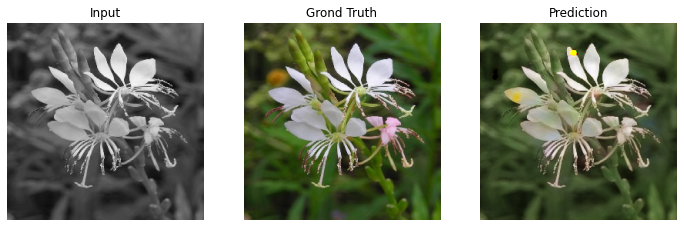


Epoch 00089: val_loss did not improve from 0.21089
200/200 [==============================] - 177s 885ms/step - loss: 0.2081 - R_loss: 0.0751 - G_loss: 0.0302 - B_loss: 0.1028 - val_loss: 0.2180 - val_R_loss: 0.0781 - val_G_loss: 0.0297 - val_B_loss: 0.1103
Epoch 90/3000
200/200 [==============================] - ETA: 0s - loss: 0.2046 - R_loss: 0.0741 - G_loss: 0.0299 - B_loss: 0.1006

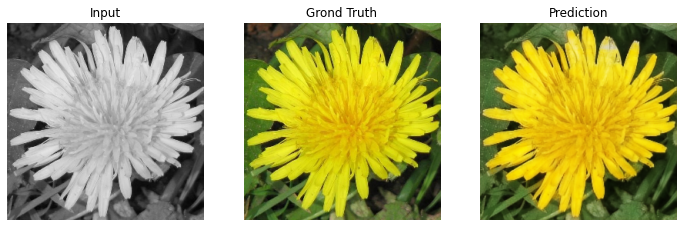


Epoch 00090: val_loss improved from 0.21089 to 0.21020, saving model to colorizer_model.h5
200/200 [==============================] - 178s 888ms/step - loss: 0.2046 - R_loss: 0.0741 - G_loss: 0.0299 - B_loss: 0.1006 - val_loss: 0.2102 - val_R_loss: 0.0772 - val_G_loss: 0.0290 - val_B_loss: 0.1040
Epoch 91/3000
200/200 [==============================] - ETA: 0s - loss: 0.2029 - R_loss: 0.0733 - G_loss: 0.0303 - B_loss: 0.0993

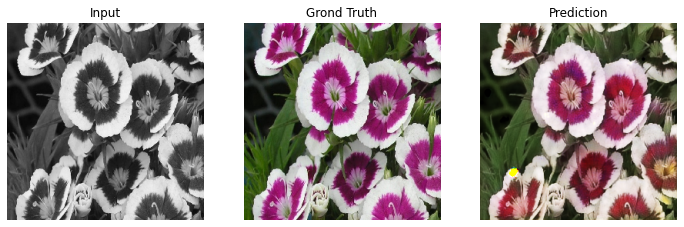


Epoch 00091: val_loss did not improve from 0.21020
200/200 [==============================] - 177s 884ms/step - loss: 0.2029 - R_loss: 0.0733 - G_loss: 0.0303 - B_loss: 0.0993 - val_loss: 0.2165 - val_R_loss: 0.0796 - val_G_loss: 0.0295 - val_B_loss: 0.1074
Epoch 92/3000
200/200 [==============================] - ETA: 0s - loss: 0.2123 - R_loss: 0.0766 - G_loss: 0.0322 - B_loss: 0.1035

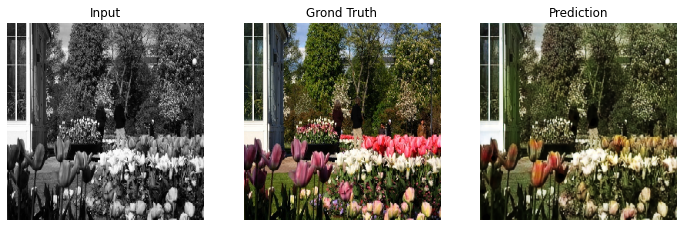


Epoch 00092: val_loss did not improve from 0.21020
200/200 [==============================] - 177s 883ms/step - loss: 0.2123 - R_loss: 0.0766 - G_loss: 0.0322 - B_loss: 0.1035 - val_loss: 0.2184 - val_R_loss: 0.0790 - val_G_loss: 0.0299 - val_B_loss: 0.1095
Epoch 93/3000
200/200 [==============================] - ETA: 0s - loss: 0.2100 - R_loss: 0.0759 - G_loss: 0.0305 - B_loss: 0.1036

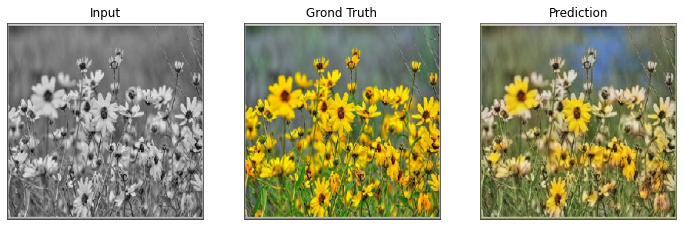


Epoch 00093: val_loss did not improve from 0.21020
200/200 [==============================] - 177s 887ms/step - loss: 0.2100 - R_loss: 0.0759 - G_loss: 0.0305 - B_loss: 0.1036 - val_loss: 0.2253 - val_R_loss: 0.0797 - val_G_loss: 0.0310 - val_B_loss: 0.1146
Epoch 94/3000
200/200 [==============================] - ETA: 0s - loss: 0.2082 - R_loss: 0.0749 - G_loss: 0.0303 - B_loss: 0.1030

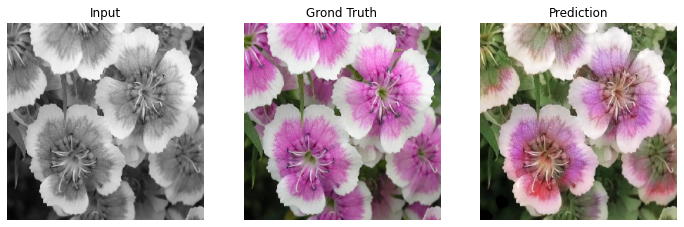


Epoch 00094: val_loss did not improve from 0.21020
200/200 [==============================] - 183s 917ms/step - loss: 0.2082 - R_loss: 0.0749 - G_loss: 0.0303 - B_loss: 0.1030 - val_loss: 0.2152 - val_R_loss: 0.0795 - val_G_loss: 0.0302 - val_B_loss: 0.1055
Epoch 95/3000
200/200 [==============================] - ETA: 0s - loss: 0.2039 - R_loss: 0.0740 - G_loss: 0.0309 - B_loss: 0.0990

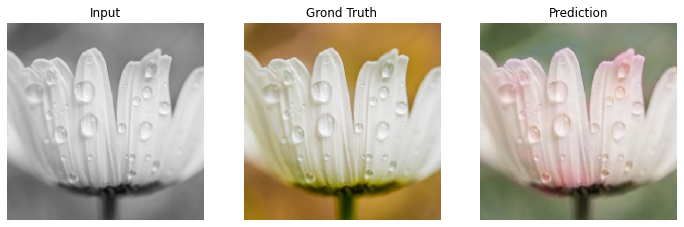


Epoch 00095: val_loss did not improve from 0.21020
200/200 [==============================] - 187s 935ms/step - loss: 0.2039 - R_loss: 0.0740 - G_loss: 0.0309 - B_loss: 0.0990 - val_loss: 0.2154 - val_R_loss: 0.0770 - val_G_loss: 0.0300 - val_B_loss: 0.1084
Epoch 96/3000
200/200 [==============================] - ETA: 0s - loss: 0.2054 - R_loss: 0.0739 - G_loss: 0.0301 - B_loss: 0.1014

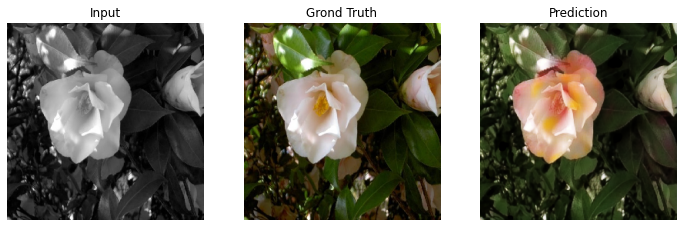


Epoch 00096: val_loss did not improve from 0.21020
200/200 [==============================] - 191s 955ms/step - loss: 0.2054 - R_loss: 0.0739 - G_loss: 0.0301 - B_loss: 0.1014 - val_loss: 0.2223 - val_R_loss: 0.0817 - val_G_loss: 0.0297 - val_B_loss: 0.1110
Epoch 97/3000
200/200 [==============================] - ETA: 0s - loss: 0.2058 - R_loss: 0.0741 - G_loss: 0.0306 - B_loss: 0.1011

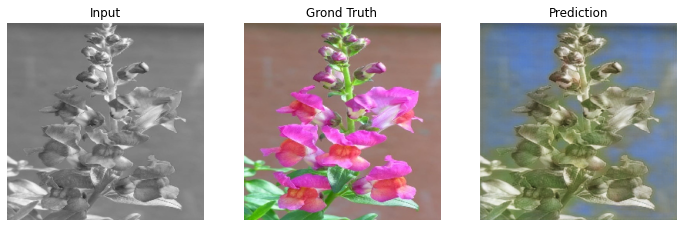


Epoch 00097: val_loss did not improve from 0.21020
200/200 [==============================] - 188s 939ms/step - loss: 0.2058 - R_loss: 0.0741 - G_loss: 0.0306 - B_loss: 0.1011 - val_loss: 0.2189 - val_R_loss: 0.0810 - val_G_loss: 0.0302 - val_B_loss: 0.1077
Epoch 98/3000
200/200 [==============================] - ETA: 0s - loss: 0.2093 - R_loss: 0.0753 - G_loss: 0.0306 - B_loss: 0.1033

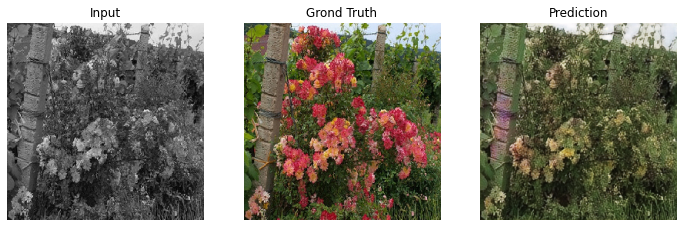


Epoch 00098: val_loss did not improve from 0.21020
200/200 [==============================] - 189s 947ms/step - loss: 0.2093 - R_loss: 0.0753 - G_loss: 0.0306 - B_loss: 0.1033 - val_loss: 0.2167 - val_R_loss: 0.0762 - val_G_loss: 0.0298 - val_B_loss: 0.1107
Epoch 99/3000
200/200 [==============================] - ETA: 0s - loss: 0.2049 - R_loss: 0.0743 - G_loss: 0.0293 - B_loss: 0.1013

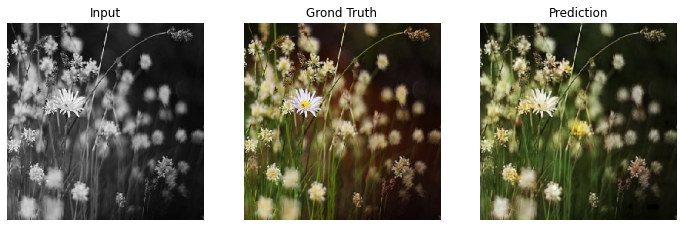


Epoch 00099: val_loss did not improve from 0.21020
200/200 [==============================] - 178s 890ms/step - loss: 0.2049 - R_loss: 0.0743 - G_loss: 0.0293 - B_loss: 0.1013 - val_loss: 0.2136 - val_R_loss: 0.0769 - val_G_loss: 0.0289 - val_B_loss: 0.1078
Epoch 100/3000
200/200 [==============================] - ETA: 0s - loss: 0.2065 - R_loss: 0.0734 - G_loss: 0.0308 - B_loss: 0.1023

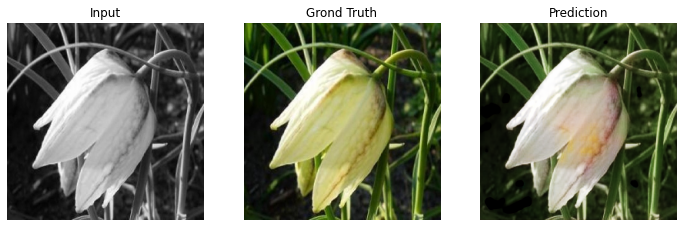


Epoch 00100: val_loss did not improve from 0.21020
200/200 [==============================] - 178s 888ms/step - loss: 0.2065 - R_loss: 0.0734 - G_loss: 0.0308 - B_loss: 0.1023 - val_loss: 0.2146 - val_R_loss: 0.0780 - val_G_loss: 0.0310 - val_B_loss: 0.1056
Epoch 101/3000
200/200 [==============================] - ETA: 0s - loss: 0.2063 - R_loss: 0.0741 - G_loss: 0.0304 - B_loss: 0.1017

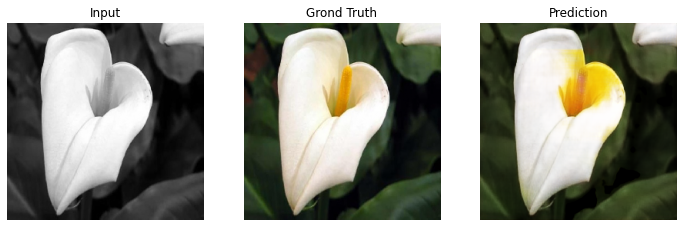


Epoch 00101: val_loss did not improve from 0.21020
200/200 [==============================] - 178s 889ms/step - loss: 0.2063 - R_loss: 0.0741 - G_loss: 0.0304 - B_loss: 0.1017 - val_loss: 0.2170 - val_R_loss: 0.0767 - val_G_loss: 0.0294 - val_B_loss: 0.1108
Epoch 102/3000
200/200 [==============================] - ETA: 0s - loss: 0.2063 - R_loss: 0.0750 - G_loss: 0.0299 - B_loss: 0.1013

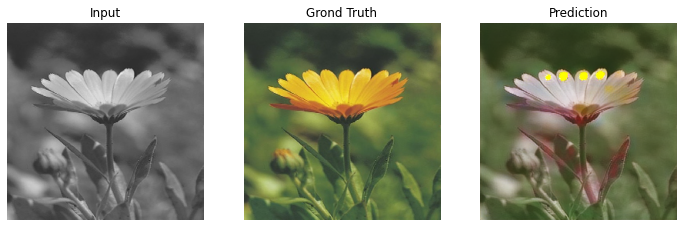


Epoch 00102: val_loss improved from 0.21020 to 0.20916, saving model to colorizer_model.h5
200/200 [==============================] - 178s 892ms/step - loss: 0.2063 - R_loss: 0.0750 - G_loss: 0.0299 - B_loss: 0.1013 - val_loss: 0.2092 - val_R_loss: 0.0762 - val_G_loss: 0.0289 - val_B_loss: 0.1040
Epoch 103/3000
200/200 [==============================] - ETA: 0s - loss: 0.2026 - R_loss: 0.0714 - G_loss: 0.0285 - B_loss: 0.1027

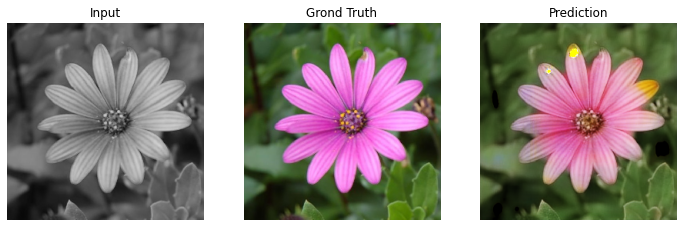


Epoch 00103: val_loss improved from 0.20916 to 0.20845, saving model to colorizer_model.h5
200/200 [==============================] - 179s 893ms/step - loss: 0.2026 - R_loss: 0.0714 - G_loss: 0.0285 - B_loss: 0.1027 - val_loss: 0.2085 - val_R_loss: 0.0759 - val_G_loss: 0.0285 - val_B_loss: 0.1041
Epoch 104/3000
200/200 [==============================] - ETA: 0s - loss: 0.2087 - R_loss: 0.0761 - G_loss: 0.0310 - B_loss: 0.1016

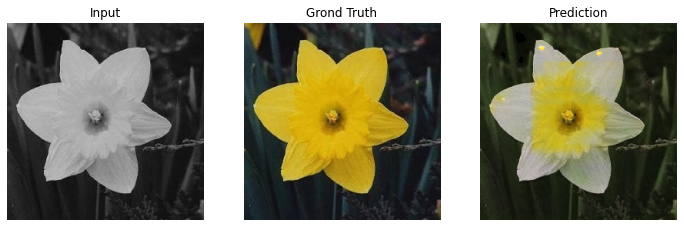


Epoch 00104: val_loss did not improve from 0.20845
200/200 [==============================] - 178s 888ms/step - loss: 0.2087 - R_loss: 0.0761 - G_loss: 0.0310 - B_loss: 0.1016 - val_loss: 0.2105 - val_R_loss: 0.0781 - val_G_loss: 0.0292 - val_B_loss: 0.1032
Epoch 105/3000
200/200 [==============================] - ETA: 0s - loss: 0.2004 - R_loss: 0.0725 - G_loss: 0.0287 - B_loss: 0.0993

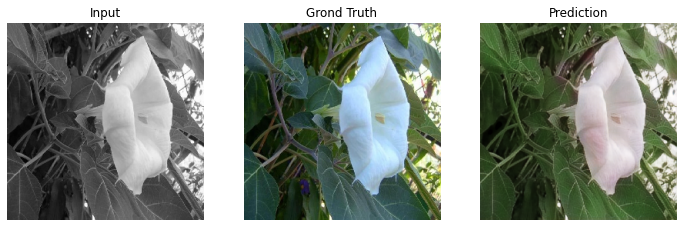


Epoch 00105: val_loss did not improve from 0.20845
200/200 [==============================] - 177s 887ms/step - loss: 0.2004 - R_loss: 0.0725 - G_loss: 0.0287 - B_loss: 0.0993 - val_loss: 0.2097 - val_R_loss: 0.0774 - val_G_loss: 0.0288 - val_B_loss: 0.1035
Epoch 106/3000
200/200 [==============================] - ETA: 0s - loss: 0.2049 - R_loss: 0.0738 - G_loss: 0.0296 - B_loss: 0.1014

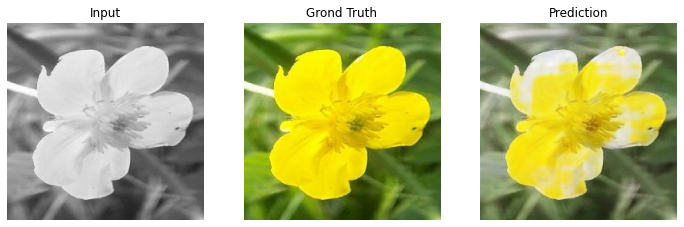


Epoch 00106: val_loss did not improve from 0.20845
200/200 [==============================] - 178s 888ms/step - loss: 0.2049 - R_loss: 0.0738 - G_loss: 0.0296 - B_loss: 0.1014 - val_loss: 0.2190 - val_R_loss: 0.0805 - val_G_loss: 0.0301 - val_B_loss: 0.1084
Epoch 107/3000
200/200 [==============================] - ETA: 0s - loss: 0.2055 - R_loss: 0.0737 - G_loss: 0.0302 - B_loss: 0.1016

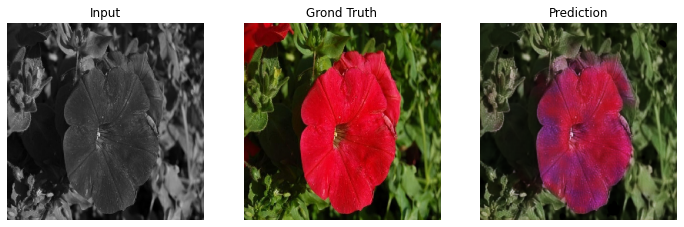


Epoch 00107: val_loss did not improve from 0.20845
200/200 [==============================] - 178s 890ms/step - loss: 0.2055 - R_loss: 0.0737 - G_loss: 0.0302 - B_loss: 0.1016 - val_loss: 0.2132 - val_R_loss: 0.0801 - val_G_loss: 0.0298 - val_B_loss: 0.1033
Epoch 108/3000
200/200 [==============================] - ETA: 0s - loss: 0.2046 - R_loss: 0.0737 - G_loss: 0.0300 - B_loss: 0.1009

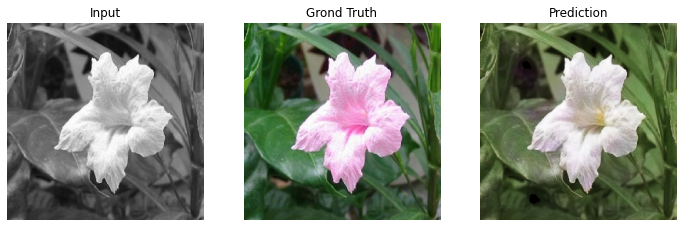


Epoch 00108: val_loss did not improve from 0.20845
200/200 [==============================] - 178s 889ms/step - loss: 0.2046 - R_loss: 0.0737 - G_loss: 0.0300 - B_loss: 0.1009 - val_loss: 0.2188 - val_R_loss: 0.0804 - val_G_loss: 0.0298 - val_B_loss: 0.1086
Epoch 109/3000
200/200 [==============================] - ETA: 0s - loss: 0.2052 - R_loss: 0.0740 - G_loss: 0.0301 - B_loss: 0.1011

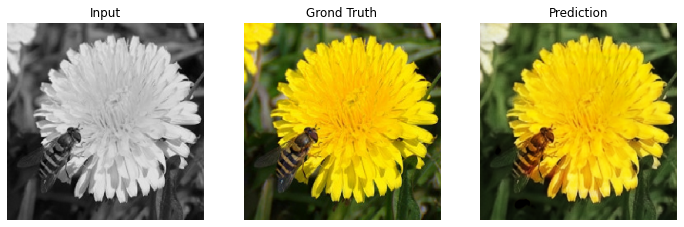


Epoch 00109: val_loss did not improve from 0.20845
200/200 [==============================] - 178s 889ms/step - loss: 0.2052 - R_loss: 0.0740 - G_loss: 0.0301 - B_loss: 0.1011 - val_loss: 0.2133 - val_R_loss: 0.0764 - val_G_loss: 0.0288 - val_B_loss: 0.1081
Epoch 110/3000
200/200 [==============================] - ETA: 0s - loss: 0.1996 - R_loss: 0.0720 - G_loss: 0.0299 - B_loss: 0.0977

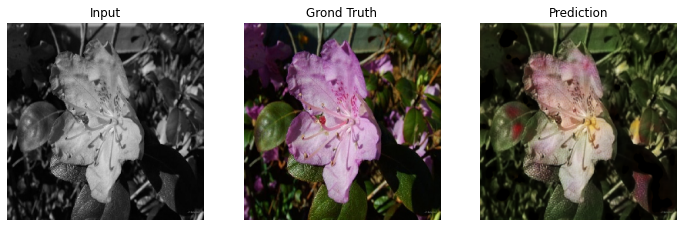


Epoch 00110: val_loss did not improve from 0.20845
200/200 [==============================] - 178s 889ms/step - loss: 0.1996 - R_loss: 0.0720 - G_loss: 0.0299 - B_loss: 0.0977 - val_loss: 0.2155 - val_R_loss: 0.0794 - val_G_loss: 0.0302 - val_B_loss: 0.1059
Epoch 111/3000
200/200 [==============================] - ETA: 0s - loss: 0.2040 - R_loss: 0.0746 - G_loss: 0.0300 - B_loss: 0.0994

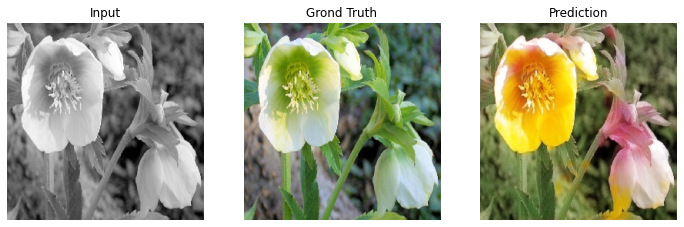


Epoch 00111: val_loss improved from 0.20845 to 0.20628, saving model to colorizer_model.h5
200/200 [==============================] - 178s 892ms/step - loss: 0.2040 - R_loss: 0.0746 - G_loss: 0.0300 - B_loss: 0.0994 - val_loss: 0.2063 - val_R_loss: 0.0765 - val_G_loss: 0.0288 - val_B_loss: 0.1010
Epoch 112/3000
200/200 [==============================] - ETA: 0s - loss: 0.2026 - R_loss: 0.0729 - G_loss: 0.0300 - B_loss: 0.0997

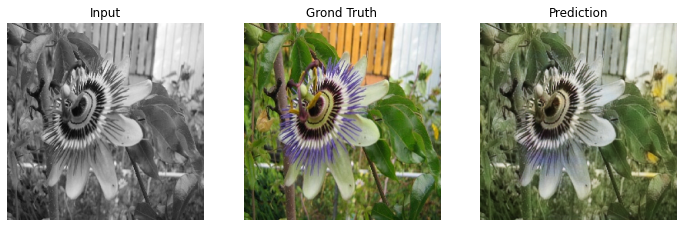


Epoch 00112: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.2026 - R_loss: 0.0729 - G_loss: 0.0300 - B_loss: 0.0997 - val_loss: 0.2092 - val_R_loss: 0.0759 - val_G_loss: 0.0286 - val_B_loss: 0.1047
Epoch 113/3000
200/200 [==============================] - ETA: 0s - loss: 0.2009 - R_loss: 0.0725 - G_loss: 0.0310 - B_loss: 0.0975

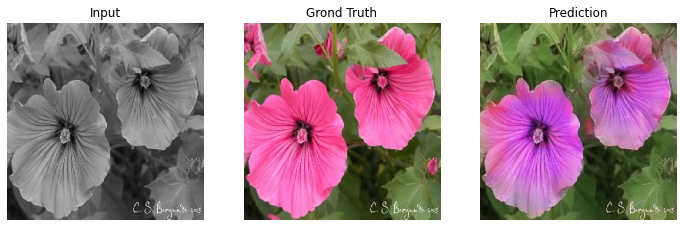


Epoch 00113: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.2009 - R_loss: 0.0725 - G_loss: 0.0310 - B_loss: 0.0975 - val_loss: 0.2113 - val_R_loss: 0.0773 - val_G_loss: 0.0294 - val_B_loss: 0.1047
Epoch 114/3000
200/200 [==============================] - ETA: 0s - loss: 0.2067 - R_loss: 0.0730 - G_loss: 0.0302 - B_loss: 0.1035

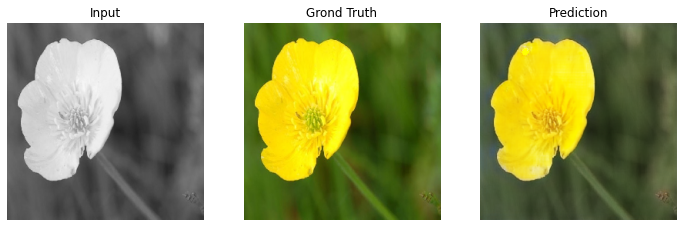


Epoch 00114: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 891ms/step - loss: 0.2067 - R_loss: 0.0730 - G_loss: 0.0302 - B_loss: 0.1035 - val_loss: 0.2157 - val_R_loss: 0.0762 - val_G_loss: 0.0320 - val_B_loss: 0.1075
Epoch 115/3000
200/200 [==============================] - ETA: 0s - loss: 0.2067 - R_loss: 0.0743 - G_loss: 0.0309 - B_loss: 0.1015

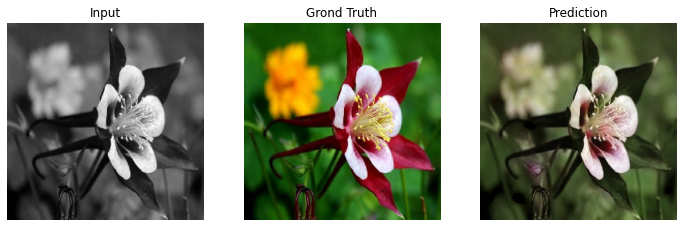


Epoch 00115: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 888ms/step - loss: 0.2067 - R_loss: 0.0743 - G_loss: 0.0309 - B_loss: 0.1015 - val_loss: 0.2181 - val_R_loss: 0.0797 - val_G_loss: 0.0289 - val_B_loss: 0.1095
Epoch 116/3000
200/200 [==============================] - ETA: 0s - loss: 0.2032 - R_loss: 0.0732 - G_loss: 0.0302 - B_loss: 0.0998

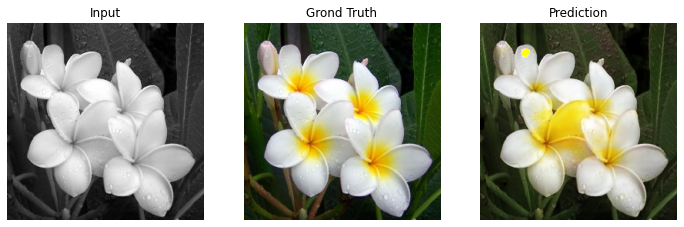


Epoch 00116: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.2032 - R_loss: 0.0732 - G_loss: 0.0302 - B_loss: 0.0998 - val_loss: 0.2179 - val_R_loss: 0.0820 - val_G_loss: 0.0315 - val_B_loss: 0.1043
Epoch 117/3000
200/200 [==============================] - ETA: 0s - loss: 0.2042 - R_loss: 0.0732 - G_loss: 0.0299 - B_loss: 0.1010

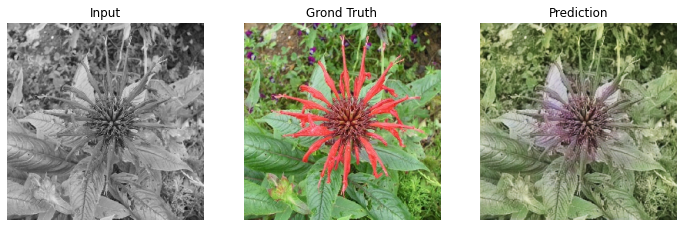


Epoch 00117: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.2042 - R_loss: 0.0732 - G_loss: 0.0299 - B_loss: 0.1010 - val_loss: 0.2137 - val_R_loss: 0.0793 - val_G_loss: 0.0294 - val_B_loss: 0.1049
Epoch 118/3000
200/200 [==============================] - ETA: 0s - loss: 0.2026 - R_loss: 0.0731 - G_loss: 0.0299 - B_loss: 0.0995

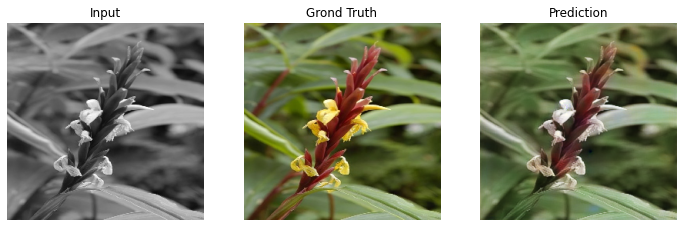


Epoch 00118: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.2026 - R_loss: 0.0731 - G_loss: 0.0299 - B_loss: 0.0995 - val_loss: 0.2150 - val_R_loss: 0.0791 - val_G_loss: 0.0293 - val_B_loss: 0.1065
Epoch 119/3000
200/200 [==============================] - ETA: 0s - loss: 0.2021 - R_loss: 0.0725 - G_loss: 0.0299 - B_loss: 0.0997

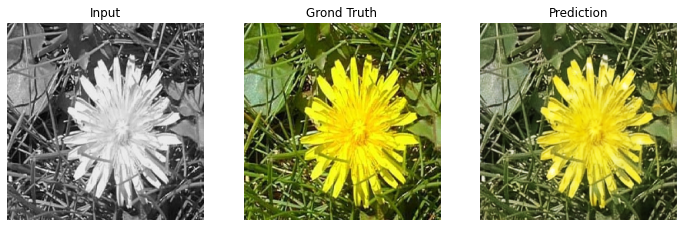


Epoch 00119: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 888ms/step - loss: 0.2021 - R_loss: 0.0725 - G_loss: 0.0299 - B_loss: 0.0997 - val_loss: 0.2086 - val_R_loss: 0.0768 - val_G_loss: 0.0282 - val_B_loss: 0.1036
Epoch 120/3000
200/200 [==============================] - ETA: 0s - loss: 0.1972 - R_loss: 0.0705 - G_loss: 0.0288 - B_loss: 0.0979

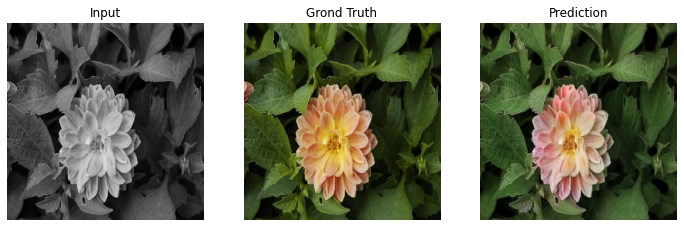


Epoch 00120: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.1972 - R_loss: 0.0705 - G_loss: 0.0288 - B_loss: 0.0979 - val_loss: 0.2091 - val_R_loss: 0.0762 - val_G_loss: 0.0295 - val_B_loss: 0.1033
Epoch 121/3000
200/200 [==============================] - ETA: 0s - loss: 0.1962 - R_loss: 0.0703 - G_loss: 0.0293 - B_loss: 0.0966

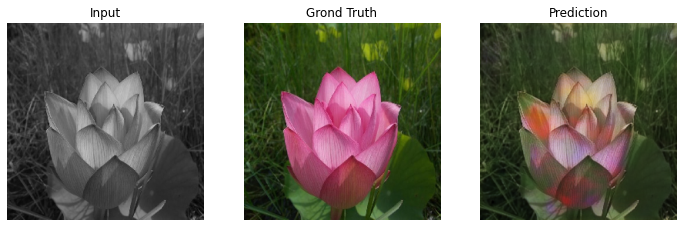


Epoch 00121: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.1962 - R_loss: 0.0703 - G_loss: 0.0293 - B_loss: 0.0966 - val_loss: 0.2171 - val_R_loss: 0.0814 - val_G_loss: 0.0289 - val_B_loss: 0.1068
Epoch 122/3000
200/200 [==============================] - ETA: 0s - loss: 0.1970 - R_loss: 0.0706 - G_loss: 0.0296 - B_loss: 0.0969

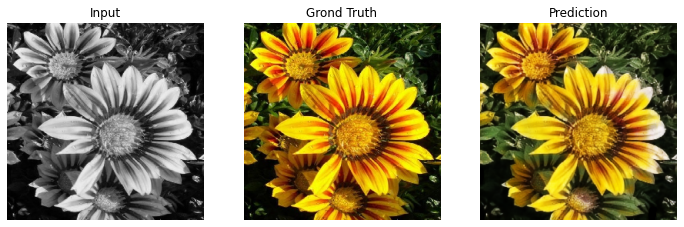


Epoch 00122: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.1970 - R_loss: 0.0706 - G_loss: 0.0296 - B_loss: 0.0969 - val_loss: 0.2094 - val_R_loss: 0.0769 - val_G_loss: 0.0279 - val_B_loss: 0.1046
Epoch 123/3000
200/200 [==============================] - ETA: 0s - loss: 0.1971 - R_loss: 0.0720 - G_loss: 0.0294 - B_loss: 0.0958

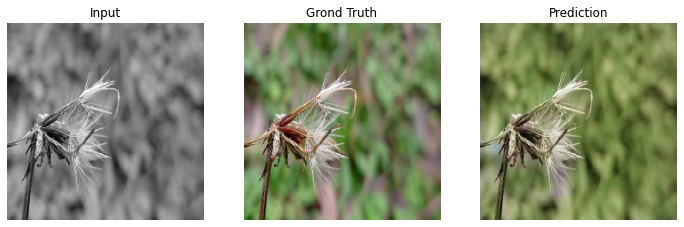


Epoch 00123: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.1971 - R_loss: 0.0720 - G_loss: 0.0294 - B_loss: 0.0958 - val_loss: 0.2079 - val_R_loss: 0.0749 - val_G_loss: 0.0284 - val_B_loss: 0.1046
Epoch 124/3000
200/200 [==============================] - ETA: 0s - loss: 0.2003 - R_loss: 0.0733 - G_loss: 0.0296 - B_loss: 0.0974

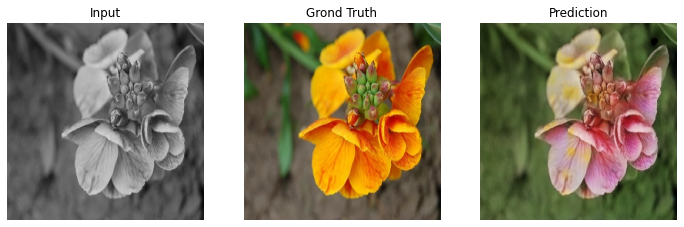


Epoch 00124: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 888ms/step - loss: 0.2003 - R_loss: 0.0733 - G_loss: 0.0296 - B_loss: 0.0974 - val_loss: 0.2137 - val_R_loss: 0.0812 - val_G_loss: 0.0294 - val_B_loss: 0.1031
Epoch 125/3000
200/200 [==============================] - ETA: 0s - loss: 0.1990 - R_loss: 0.0720 - G_loss: 0.0289 - B_loss: 0.0981

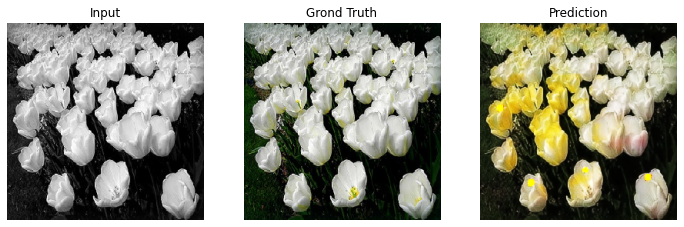


Epoch 00125: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.1990 - R_loss: 0.0720 - G_loss: 0.0289 - B_loss: 0.0981 - val_loss: 0.2140 - val_R_loss: 0.0780 - val_G_loss: 0.0285 - val_B_loss: 0.1075
Epoch 126/3000
200/200 [==============================] - ETA: 0s - loss: 0.1994 - R_loss: 0.0719 - G_loss: 0.0297 - B_loss: 0.0977

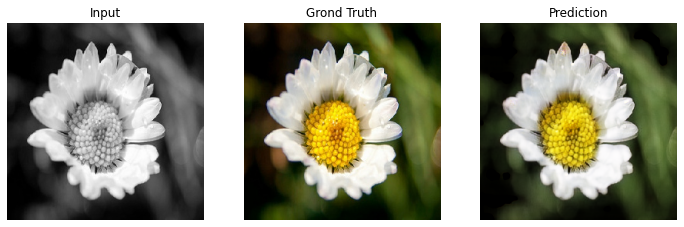


Epoch 00126: val_loss did not improve from 0.20628
200/200 [==============================] - 180s 898ms/step - loss: 0.1994 - R_loss: 0.0719 - G_loss: 0.0297 - B_loss: 0.0977 - val_loss: 0.2095 - val_R_loss: 0.0778 - val_G_loss: 0.0287 - val_B_loss: 0.1029
Epoch 127/3000
200/200 [==============================] - ETA: 0s - loss: 0.1999 - R_loss: 0.0731 - G_loss: 0.0288 - B_loss: 0.0980

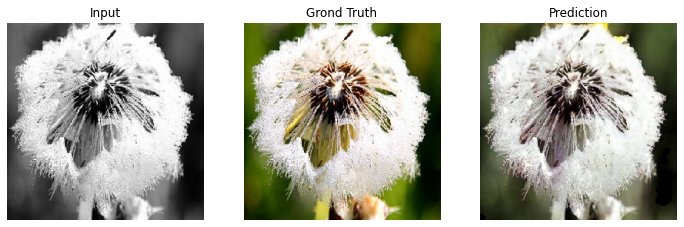


Epoch 00127: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.1999 - R_loss: 0.0731 - G_loss: 0.0288 - B_loss: 0.0980 - val_loss: 0.2140 - val_R_loss: 0.0762 - val_G_loss: 0.0295 - val_B_loss: 0.1083
Epoch 128/3000
200/200 [==============================] - ETA: 0s - loss: 0.1962 - R_loss: 0.0710 - G_loss: 0.0284 - B_loss: 0.0968

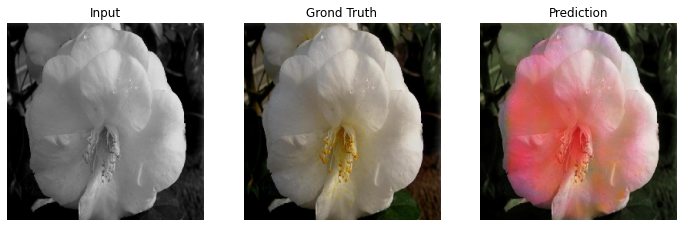


Epoch 00128: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 890ms/step - loss: 0.1962 - R_loss: 0.0710 - G_loss: 0.0284 - B_loss: 0.0968 - val_loss: 0.2092 - val_R_loss: 0.0747 - val_G_loss: 0.0279 - val_B_loss: 0.1066
Epoch 129/3000
200/200 [==============================] - ETA: 0s - loss: 0.1991 - R_loss: 0.0724 - G_loss: 0.0298 - B_loss: 0.0969

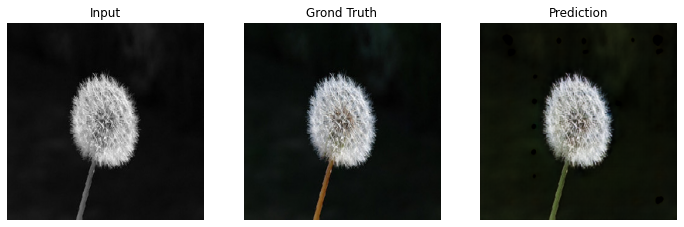


Epoch 00129: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 888ms/step - loss: 0.1991 - R_loss: 0.0724 - G_loss: 0.0298 - B_loss: 0.0969 - val_loss: 0.2114 - val_R_loss: 0.0761 - val_G_loss: 0.0284 - val_B_loss: 0.1069
Epoch 130/3000
200/200 [==============================] - ETA: 0s - loss: 0.2009 - R_loss: 0.0724 - G_loss: 0.0296 - B_loss: 0.0989

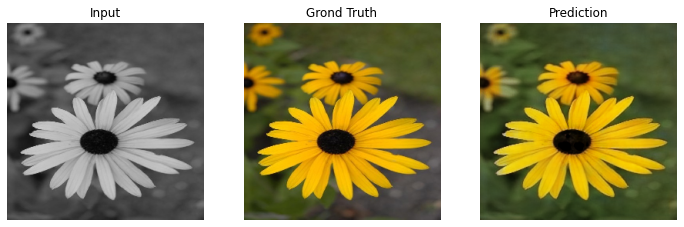


Epoch 00130: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 889ms/step - loss: 0.2009 - R_loss: 0.0724 - G_loss: 0.0296 - B_loss: 0.0989 - val_loss: 0.2087 - val_R_loss: 0.0768 - val_G_loss: 0.0284 - val_B_loss: 0.1035
Epoch 131/3000
200/200 [==============================] - ETA: 0s - loss: 0.1975 - R_loss: 0.0712 - G_loss: 0.0292 - B_loss: 0.0971

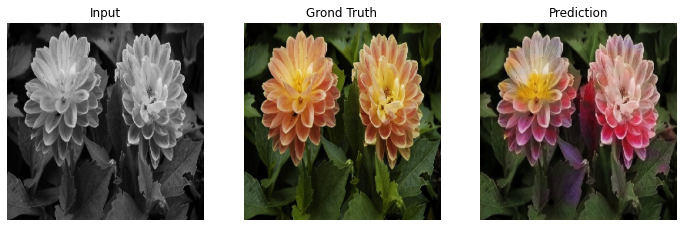


Epoch 00131: val_loss did not improve from 0.20628
200/200 [==============================] - 178s 888ms/step - loss: 0.1975 - R_loss: 0.0712 - G_loss: 0.0292 - B_loss: 0.0971 - val_loss: 0.2154 - val_R_loss: 0.0798 - val_G_loss: 0.0308 - val_B_loss: 0.1048
Epoch 132/3000
200/200 [==============================] - ETA: 0s - loss: 0.2021 - R_loss: 0.0725 - G_loss: 0.0294 - B_loss: 0.1002

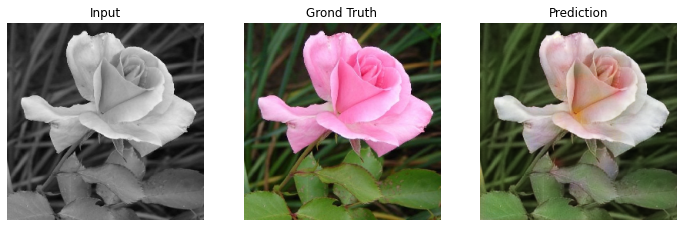


Epoch 00132: val_loss improved from 0.20628 to 0.20595, saving model to colorizer_model.h5
200/200 [==============================] - 178s 892ms/step - loss: 0.2021 - R_loss: 0.0725 - G_loss: 0.0294 - B_loss: 0.1002 - val_loss: 0.2059 - val_R_loss: 0.0751 - val_G_loss: 0.0284 - val_B_loss: 0.1024
Epoch 133/3000
200/200 [==============================] - ETA: 0s - loss: 0.1965 - R_loss: 0.0715 - G_loss: 0.0288 - B_loss: 0.0962

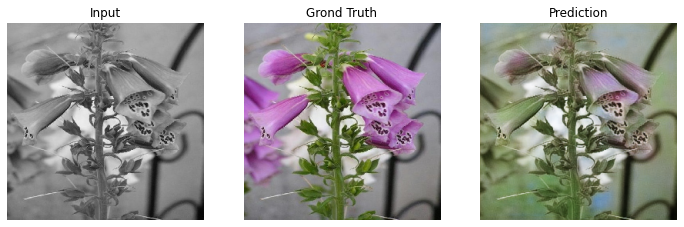


Epoch 00133: val_loss did not improve from 0.20595
200/200 [==============================] - 178s 889ms/step - loss: 0.1965 - R_loss: 0.0715 - G_loss: 0.0288 - B_loss: 0.0962 - val_loss: 0.2115 - val_R_loss: 0.0775 - val_G_loss: 0.0279 - val_B_loss: 0.1060
Epoch 134/3000
200/200 [==============================] - ETA: 0s - loss: 0.1980 - R_loss: 0.0720 - G_loss: 0.0288 - B_loss: 0.0972

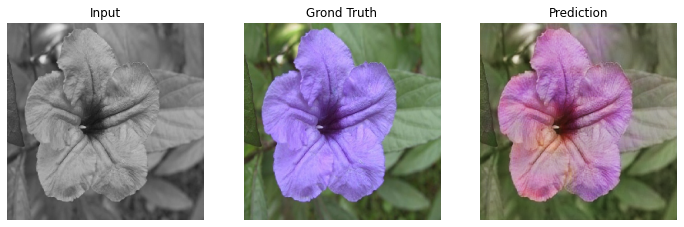


Epoch 00134: val_loss did not improve from 0.20595
200/200 [==============================] - 178s 888ms/step - loss: 0.1980 - R_loss: 0.0720 - G_loss: 0.0288 - B_loss: 0.0972 - val_loss: 0.2097 - val_R_loss: 0.0780 - val_G_loss: 0.0288 - val_B_loss: 0.1029
Epoch 135/3000
200/200 [==============================] - ETA: 0s - loss: 0.1994 - R_loss: 0.0726 - G_loss: 0.0287 - B_loss: 0.0980

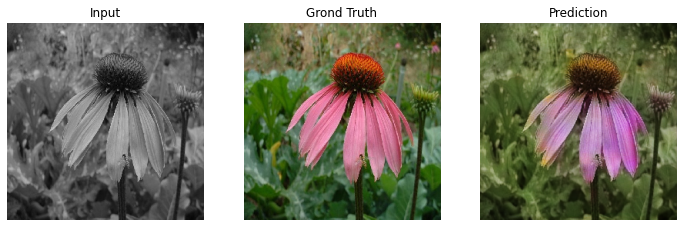


Epoch 00135: val_loss did not improve from 0.20595
200/200 [==============================] - 178s 889ms/step - loss: 0.1994 - R_loss: 0.0726 - G_loss: 0.0287 - B_loss: 0.0980 - val_loss: 0.2137 - val_R_loss: 0.0771 - val_G_loss: 0.0289 - val_B_loss: 0.1077
Epoch 136/3000
 99/200 [=============>................] - ETA: 1:15 - loss: 0.2040 - R_loss: 0.0732 - G_loss: 0.0299 - B_loss: 0.1009

In [ ]:
disp = predict_disp()
check = ModelCheckpoint('colorizer_model.h5', save_best_only = True, verbose = True)
logger = tf.keras.callbacks.CSVLogger('log.csv', separator = ",", append = True)
model.fit(train_data, epochs = 3000, validation_data = (val_data), steps_per_epoch = 200, 
          callbacks = [disp, check, logger], validation_steps = 100, initial_epoch = 39)

## Model Evaluation

In [29]:
result = pd.read_csv('log.csv')[['epoch', 'loss', 'val_loss']]
result.head(2)

,epoch,loss,val_loss
0,0,0.344367,0.467089
1,1,0.289224,0.277535


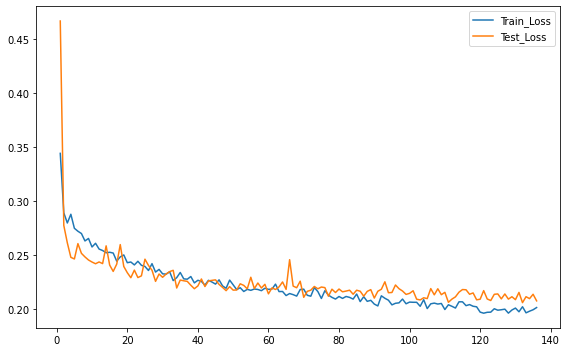

In [44]:
plt.figure(figsize = (8, 5))
plt.plot(result['epoch']+1, result['loss'], label = 'Train_Loss')
plt.plot(result['epoch']+1, result['val_loss'], label = 'Test_Loss')
plt.tight_layout()
plt.legend()
plt.show()

## Sample Test Predictions

In [8]:
model = load_model('colorizer_model.h5')

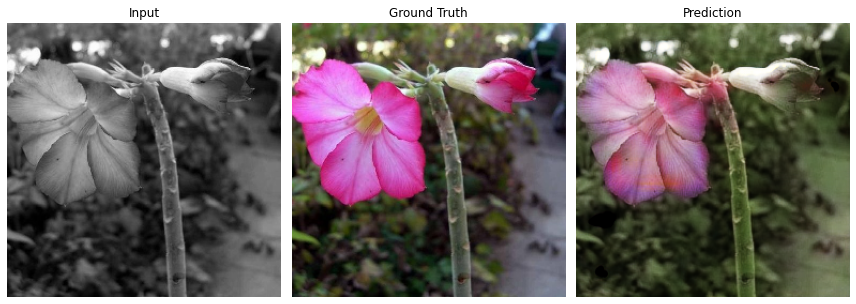

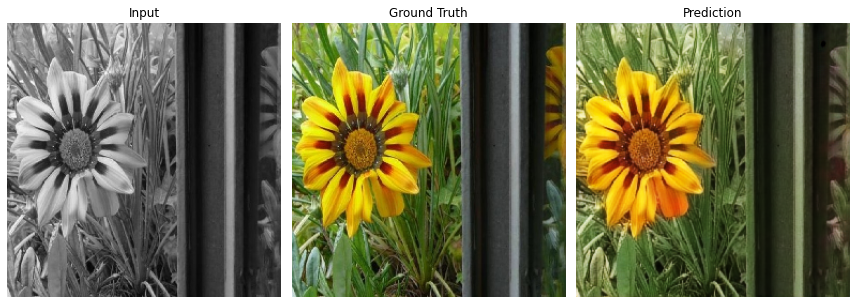

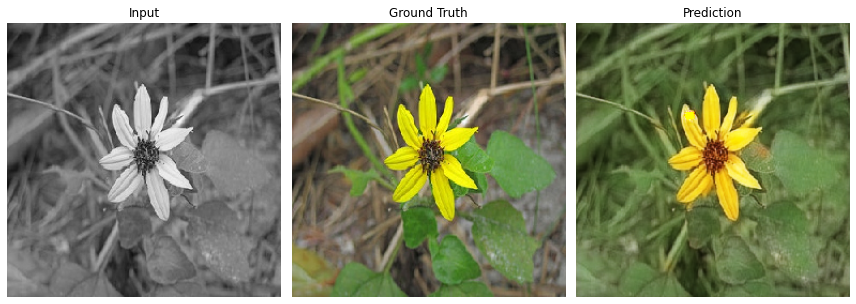

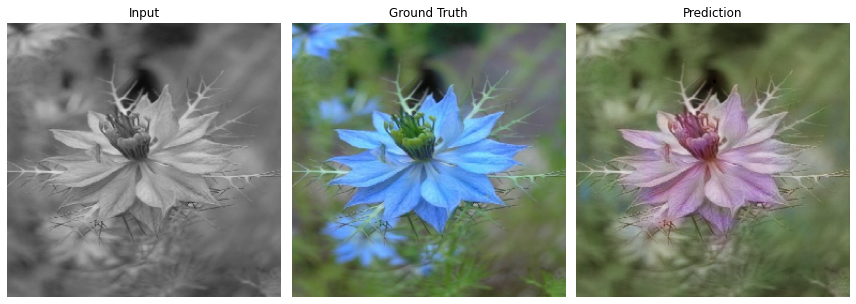

In [36]:
for i in range(4):
    f, axarr = plt.subplots(1, 3)
    X, Y = next(val_data)
    n = np.random.randint(0, len(X), 1)[0]
    Y1, Y2, Y3 = Y
    Y1, Y2, Y3 = Y1[n], Y2[n], Y3[n]
    Y = Y1, Y2, Y3
    pred = model.predict(np.expand_dims(X[n], axis = 0))

    axarr[0].imshow(X[n], cmap = 'gray')
    axarr[0].title.set_text('Input')
    axarr[0].axis('off')

    gt = img_rebuilder(X[n], Y)
    axarr[1].imshow(gt)
    axarr[1].title.set_text('Ground Truth')
    axarr[1].axis('off')

    pred = img_rebuilder(X[n], pred)[0]
    axarr[2].imshow(pred)
    axarr[2].title.set_text('Prediction')
    axarr[2].axis('off')

    f.set_figwidth(12)
    f.set_figheight(12)
    f.tight_layout()
    plt.show()


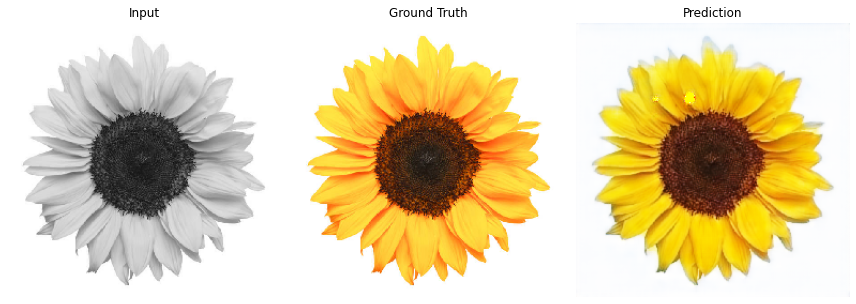

In [42]:
test = r"C:\Users\Admin\Downloads\folwer.jpg"
test = 'sun.jpg'
X = np.array(load_img(test, target_size = (img_h, img_w)))/255
test = rgb2gray(X)
test = gray2rgb(test)

f, axarr = plt.subplots(1, 3)
axarr[0].imshow(test)
axarr[0].title.set_text('Input')
axarr[0].axis('off')

axarr[1].imshow(X)
axarr[1].title.set_text('Ground Truth')
axarr[1].axis('off')

test = np.expand_dims(test, 0)
pred = model.predict(test)
pred = img_rebuilder(test, pred)[0]
axarr[2].imshow(pred)
axarr[2].title.set_text('Prediction')
axarr[2].axis('off')

f.set_figwidth(12)
f.set_figheight(12)
f.tight_layout()

## Future Work: 
- Experiment with more complex ecoder like Vision Transformer.
- More and mixed domain data.
- Build more advance model to colorize old black and white videos/movies.